<h1><center> 02806 Social data analysis and visualization <br> <br> Final Project Assignment B</center></h1>


- [Click to access our website](https://social-data-group32.boxmode.io/)




- This explainer notebook should contain all the behind the scenes data-analysis stuff, details on the dataset, why you've selected these particular visualizations, explanations methodology, etc.

- Make sure that you use references when they're needed and follow academic standards.

- The notebook should contain your analysis and code. Please structure it into the following sections



In [26]:
# install required function library
!pip install xlrd
!pip install --upgrade pandas
!pip install --upgrade xlrd
!pip install pmdarima
!pip install geopandas
!pip install plotly 

In [27]:
import xlrd
import pandas as pd
from pandas import DataFrame
import numpy as np
import matplotlib.pyplot as plt
import requests
import urllib.parse
import folium
import operator
from bokeh.palettes import Spectral10
import warnings
warnings.filterwarnings('ignore')
from folium import plugins
from folium.plugins import HeatMap
import geopandas as gpd
import plotly.express as px
import plotly.graph_objs as go
from collections import Counter
import calendar
import itertools
from plotly.offline import init_notebook_mode
from pmdarima.arima import auto_arima
import plotly.io as pio

pio.renderers.default = "colab"
init_notebook_mode(connected=True)

In [28]:
# Mount Google Cloud
from google.colab import drive
drive.mount('/content/gdrive')	

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
import os
os.chdir("gdrive/MyDrive/Social_course") 

# Part 1: Motivation

## 1.1 What is your dataset?

We selected Poland's database of air quality pollution classification statistics in 2016-2020 and energy consumption classification statistics in 2017-2020.

Source：

1）Air Quality ：

https://powietrze.gios.gov.pl/pjp/archives

2）Energy Consumption：

https://stat.gov.pl/en/topics/environment-energy/energy/consumption-of-fuels-and-energy-carriers-in-2017,8,12.html

https://stat.gov.pl/en/topics/environment-energy/energy/consumption-of-fuels-and-energy-carriers-in-2018,8,13.html

https://stat.gov.pl/en/topics/environment-energy/energy/consumption-of-fuels-and-energy-carriers-in-2019,8,14.html

https://stat.gov.pl/en/topics/environment-energy/energy/consumption-of-fuels-and-energy-carriers-in-2020,8,15.html

## 1.2 Why did you choose this/these particular dataset(s)?

Because we want to explore the impact of human activities on air pollution. As we all know, human society is developing at an extremely fast speed. The scale of development in industry, agriculture, science, and technology is constantly expanding, and the population is also increasing, which means that human activities are increasing at an explosive rate. Therefore, in normal times, we rarely have the opportunity to see that human activities do not increase but decrease, and it is difficult to obtain statistics on air pollution when human activities decrease.


The arrival of Covid19 broke this situation, and lockdowns began to appear everywhere, and human activities decreased. Of course, this is not good for the development of society, but it also gives us a very rare opportunity to calm down and take a good look at the environment, and see how our activities will affect the environment? More specifically, what impact will it have on the world's air quality? And then we can think about what we can do for environmental protection, and make the environment in which we live to become better. After all, protecting the environment is saving ourselves.


Therefore, we chose these two datasets for research and analysis. At the same time, these two datasets are relatively large and contain relatively complete data. Especially the air pollution dataset, which has two record methods, hourly and daily, and a large amount of time series is helpful for our later analysis and statistics.

At the same time, Poland has implemented lockdown measures several times since March 2020 to combat the spread of COVID-19<sup>[1]</sup>, so we specially included the data in 2020 for comparison with the other data in previous years.

## 1.3 What was your goal for the end user's experience?

We wanted to explore the impact of the epidemic on air quality to get insight into the enormous damage that human socialization is doing to our nature. It was the burning of coal that caused the rise in SO2, NO2, and PM2.5 levels in air pollution. We hope that after reading our story, the reader will be inspired to be more environmentally conscious.

# Part 2: Basic Statistics

## 2.1 Explore the air quality


- Write about your choices in <font color='blue'>data cleaning and preprocessing </font>

In [3]:
geo_data = gpd.read_file('./poland.geojson')
province = {'Ds':'dolnośląskie', 'Kp':'kujawsko-pomorskie', 'Lb':'lubelskie', 'Lu':'lubuskie', 'Mz':'mazowieckie', 'Mp':'małopolskie', 'Op':'opolskie', 'Pk':'podkarpackie', 'Pd':'podlaskie', 'Pm':'pomorskie', 'Wm':'warmińsko-mazurskie', 'Wp':'wielkopolskie', 'Zp':'zachodniopomorskie', 'Ld':'łódzkie', 'Sl':'śląskie', 'Sk':'świętokrzyskie'}

# Take a example for PM2.5 in 2020
air_data_2020 = pd.read_excel('./2020/2020_PM25_24g.xlsx')
air_data_2020.head(10)

,Nr,1,2,3,4,5,6,7,8,9,...,57,58,59,60,61,62,63,64,65,66
0,Kod stacji,DsLegPolarna,DsOsieczow21,DsWalbrzWyso,DsWrocNaGrob,DsZgorBohGet,KpBydBerling,KpChelmLunawMOB,KpGrudSienki,KpToruDziewu,...,WmOlsPuszkin,WmOstrPilsud,WmPuszczaBor,WpKaliSawick,WpPleszAlMic,WpPoznDabrow,ZpKoszSpasow,ZpMyslZaBram,ZpSzczAndr01,ZpSzczec1Maj
1,Wskaźnik,PM2.5,PM2.5,PM2.5,PM2.5,PM2.5,PM2.5,PM2.5,PM2.5,PM2.5,...,PM2.5,PM2.5,PM2.5,PM2.5,PM2.5,PM2.5,PM2.5,PM2.5,PM2.5,PM2.5
2,Czas uśredniania,24g,24g,24g,24g,24g,24g,24g,24g,24g,...,24g,24g,24g,24g,24g,24g,24g,24g,24g,24g
3,Jednostka,ug/m3,ug/m3,ug/m3,ug/m3,ug/m3,ug/m3,ug/m3,ug/m3,ug/m3,...,ug/m3,ug/m3,ug/m3,ug/m3,ug/m3,ug/m3,ug/m3,ug/m3,ug/m3,ug/m3
4,Kod stanowiska,DsLegPolarna-PM2.5-24g,DsOsieczow21-PM2.5-24g,DsWalbrzWyso-PM2.5-24g,DsWrocNaGrob-PM2.5-24g,DsZgorBohGet-PM2.5-24g,KpBydBerling-PM2.5-24g,KpChelmLunawMOB-PM2.5-24g,KpGrudSienki-PM2.5-24g,KpToruDziewu-PM2.5-24g,...,WmOlsPuszkin-PM2.5-24g,WmOstrPilsud-PM2.5-24g,WmPuszczaBor-PM2.5-24g,WpKaliSawick-PM2.5-24g,WpPleszAlMic-PM2.5-24g,WpPoznDabrow-PM2.5-24g,ZpKoszSpasow-PM2.5-24g,ZpMyslZaBram-PM2.5-24g,ZpSzczAndr01-PM2.5-24g,ZpSzczec1Maj-PM2.5-24g
5,2020-01-01 00:00:00,30.98,16.8,20.5,17.67,26.94,16.56803,NaN,26.530622,19.405164,...,NaN,12.7,8.69,19.32,30.14,17.73,14.7,16.33,18.2,11.78
6,2020-01-02 00:00:00,86.62,NaN,24.64,58.95,23.57,25.704523,NaN,33.5877,26.592335,...,NaN,24.76,14.08,47.88,49.56,47.72,11.64,31.39,16.76,13.59
7,2020-01-03 00:00:00,30.38,20.14,22.98,45.12,26.81,19.335258,NaN,31.491035,28.243589,...,25.09,24.77,24.35,36.73,31.79,22.85,14.34,13.43,9.01,NaN
8,2020-01-04 00:00:00,6.88,8.01,6,6.69,8.65,4.576195,NaN,12.289663,6.27497,...,6.14,5.11,6.81,8.88,13.05,8.72,3.99,5.62,3.97,NaN
9,2020-01-05 00:00:00,13.05,13.11,22.12,12.41,15.04,11.087618,NaN,16.831946,10.100052,...,8.81,9.05,4.94,21.14,25.04,16.48,5.26,12.52,6.13,NaN


It can be easily seen that the columns in the data indicate the air monitoring points and starting from the fifth row, the air quality of PM2.5 will be recorded at each day's interval. What we need is the average PM2.5 for different provinces in different months (averaging the data daily can have large errors, so monthly averages are used), and we have different pollutants in different years, so we will build a function to preprocess it.

In [4]:
air_data_2020.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 371 entries, 0 to 370
Data columns (total 67 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Nr      371 non-null    object
 1   1       369 non-null    object
 2   2       364 non-null    object
 3   3       364 non-null    object
 4   4       340 non-null    object
 5   5       367 non-null    object
 6   6       371 non-null    object
 7   7       363 non-null    object
 8   8       354 non-null    object
 9   9       346 non-null    object
 10  10      371 non-null    object
 11  11      365 non-null    object
 12  12      353 non-null    object
 13  13      371 non-null    object
 14  14      371 non-null    object
 15  15      371 non-null    object
 16  16      365 non-null    object
 17  17      367 non-null    object
 18  18      370 non-null    object
 19  19      371 non-null    object
 20  20      320 non-null    object
 21  21      371 non-null    object
 22  22      358 non-null    ob

Observing our data, it is easily noticed there are some missing values, so it is proof we better use the month average instead to use day averages.

In [5]:
def preprocess(data, year, method):
    # data: the data you want to preprocess
    # year: the year you use in data
    # method: Use 1h or 24h interval to record

    # geo-data 
    geo_data = gpd.read_file('poland.geojson')
    geo_data.columns = ['province_id', 'province', 'geometry']
    province_id_index = {}
    for index, i in enumerate(geo_data['province']):
        province_id_index[i] = index
    
    # province
    province_list = {}
    for index,i in enumerate(data.iloc[0][1:]):
        string = i[0:2]
        temp = province[string]
        if temp in province_list.keys():
            province_list[temp].append(index+1)
        else:
            province_list[temp] = [index+1]

    # month_day
    month = [1,2,3,4,5,6,7,8,9,10,11,12]
    if method == 24:   
        if calendar.isleap(year):
            month_days = [5, 31, 29, 31, 30, 31, 30, 31, 31, 30, 31, 30, 31]
        else:
            month_days = [5, 31, 28, 31, 30, 31, 30, 31, 31, 30, 31, 30, 31]
    else:
        if calendar.isleap(year):
            month_days = [5, 744, 696, 744, 720, 744, 720, 744, 744, 720, 744, 720, 744]
        else:
            month_days = [5, 744, 672, 744, 720, 744, 720, 744, 744, 720, 744, 720, 744]
    temp = 0
    for index, i in enumerate(month_days):
        temp = temp + i
        month_days[index] = temp
    
    new_data = pd.DataFrame(columns=['time', 'year', 'month', 'province', 'province_id', 'data'])
    for i in range(len(month_days)-1):
        mean = data.iloc[month_days[i] : month_days[i+1]][1:].mean()
        time = str(year) + '_' + str(month[i])
        for j in province_list.keys():
            temp = province_list[j]
            mean_province = float(mean[temp].mean())
            province_id = province_id_index[j]
            df = {'time':time, 'year':year, 'month':month[i], 'province':j, 'province_id':province_id, 'data':mean_province}
            new_data = new_data.append(df, ignore_index=True)
    new_data['data'] = new_data['data'].astype(np.float64)
    return new_data

As mentioned above, the columns represent the names of the air monitoring points, and the first two letters show the province name's abbreviation. According to this information, we could split our data as individual probvince. Because we want to draw a heating map with geo-data, we would add a new column **'Province_ID'**, and bundle it with our geo-data to draw Choropleth Maps.

In [6]:
# Preprocessing with PM2.5
air_data_2020 = pd.read_excel('./2020/2020_PM25_24g.xlsx')
pm25_2020 = preprocess(air_data_2020, 2020, 24)

air_data_2019 = pd.read_excel('./2019/2019_PM25_24g.xlsx')
pm25_2019 = preprocess(air_data_2019, 2019, 24)

air_data_2018 = pd.read_excel('./2018/2018_PM25_24g.xlsx')
air_data_2018.iloc[5:,1:] = air_data_2018.iloc[5:,1:].apply(lambda x : x.str.replace(',', '.')).astype(float)
pm25_2018 = preprocess(air_data_2018, 2018, 24)

air_data_2017 = pd.read_excel('./2017/2017_PM25_24g.xlsx')
air_data_2017.iloc[5:,1:] = air_data_2017.iloc[5:,1:].apply(lambda x : x.str.replace(',', '.')).astype(float)
pm25_2017 = preprocess(air_data_2017, 2017, 24)

air_data_2016 = pd.read_excel('./2016/2016_PM2.5_24g.xlsx')
air_data_2016.iloc[5:,1:] = air_data_2016.iloc[5:,1:].apply(lambda x : x.str.replace(',', '.')).astype(float)
pm25_2016 = preprocess(air_data_2016, 2016, 24)

pm25 = pd.concat([pm25_2016, pm25_2017, pm25_2018, pm25_2019, pm25_2020])

In the preprocessing, we would notice the format after the 2019 year is different from the data before. In the data before the 2019 year, they would use ',' to represent '.' So we need to replace them and transfer them to float. Besides, our operation would do with other air pollution.

In [7]:
# Preprocessing with So2
air_data_2020 = pd.read_excel('./2020/2020_SO2_1g.xlsx')
So2_2020 = preprocess(air_data_2020, 2020, 1)

air_data_2019 = pd.read_excel('./2019/2019_SO2_1g.xlsx')
So2_2019 = preprocess(air_data_2019, 2019, 1)

air_data_2018 = pd.read_excel('./2018/2018_SO2_1g.xlsx')
air_data_2018.iloc[5:,1:] = air_data_2018.iloc[5:,1:].apply(lambda x : x.str.replace(',', '.')).astype(float)
So2_2018 = preprocess(air_data_2018, 2018, 1)

air_data_2017 = pd.read_excel('./2017/2017_SO2_1g.xlsx')
air_data_2017.iloc[5:,1:] = air_data_2017.iloc[5:,1:].apply(lambda x : x.str.replace(',', '.')).astype(float)
So2_2017 = preprocess(air_data_2017, 2017, 1)

air_data_2016 = pd.read_excel('./2016/2016_SO2_1g.xlsx')
air_data_2016.iloc[5:,1:] = air_data_2016.iloc[5:,1:].apply(lambda x : x.str.replace(',', '.')).astype(float)
So2_2016 = preprocess(air_data_2016, 2016, 1)

So2 = pd.concat([So2_2016, So2_2017, So2_2018, So2_2019, So2_2020])

In [8]:
# Preprocessing with No2
air_data_2020 = pd.read_excel('./2020/2020_NO2_1g.xlsx')
No2_2020 = preprocess(air_data_2020, 2020, 1)

air_data_2019 = pd.read_excel('./2019/2019_NO2_1g.xlsx')
No2_2019 = preprocess(air_data_2019, 2019, 1)

air_data_2018 = pd.read_excel('./2018/2018_NO2_1g.xlsx')
air_data_2018.iloc[5:,1:] = air_data_2018.iloc[5:,1:].apply(lambda x : x.str.replace(',', '.')).astype(float)
No2_2018 = preprocess(air_data_2018, 2018, 1)

air_data_2017 = pd.read_excel('./2017/2017_NO2_1g.xlsx')
air_data_2017.iloc[5:,1:] = air_data_2017.iloc[5:,1:].apply(lambda x : x.str.replace(',', '.')).astype(float)
No2_2017 = preprocess(air_data_2017, 2017, 1)

air_data_2016 = pd.read_excel('./2016/2016_NO2_1g.xlsx')
air_data_2016.iloc[5:,1:] = air_data_2016.iloc[5:,1:].apply(lambda x : x.str.replace(',', '.')).astype(float)
No2_2016 = preprocess(air_data_2016, 2016, 1)

No2 = pd.concat([No2_2016, No2_2017, No2_2018, No2_2019, No2_2020])

After that, we obtain **So2, No2, and PM2.5** data.

- Write a short section that discusses the dataset stats, containing key points/plots from your <font color ='blue'>exploratory data analysis.</font>

In [9]:
pm_2020 = pm25[pm25['year'] == 2020]
pm_2020_04 = pm_2020[pm_2020['month'] == 4]



fig = px.choropleth(data_frame=pm_2020_04, geojson=geo_data, color='data', locations='province_id',  
                    template="none", scope='europe', title= 'Average PM2.5 Pollution in Poland in April 2020')
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()



Above, we show the Average PM2.5 Pollution in Poland between 2019 to 2020.

In [10]:
so2_2020 = So2[So2['year'] == 2020]
so2_2020_04 = so2_2020[so2_2020['month'] == 4]

fig = px.choropleth(data_frame=so2_2020_04, geojson=geo_data, color='data', locations='province_id',  
                    template="none", scope='europe', title= 'Average So2 Pollution in Poland in April 2020')
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()




Above, we show the Average So2 Pollution in Poland between 2019 to 2020

In [11]:
No2_2020 = No2[No2['year'] == 2020]
No2_2020_04 = No2_2020[No2_2020['month'] == 4]

fig = px.choropleth(data_frame=No2_2020_04, geojson=geo_data, color='data', locations='province_id',  
                    template="none", scope='europe', title= 'Average No2 Pollution in Poland in April 2020')
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

Above, we show the Average No2 Pollution in Poland between 2019 to 2020.

## 2.2 Explore the energy consumption

- Write about your choices in <font color='blue'>data cleaning and preprocessing </font>

Because our project is mainly to explore the reasons for the change in air pollution, the selection of this part of the data set needs to correspond to the year selected by the air pollution data set, so we selected the 2017-2020 air pollution data set to explore the relationship between air pollution and energy consumption in several years.

1. We manually processed the table in Excel, including deleting some Polish words and comments in the table, and adjusting the position of some words

2. Use python to process all sub-tables in Excel, including extracting basic information such as the type of energy consumption, the amount of energy consumption, province name, the user of energy, etc., and store these data in the 'dataframe'.

3. Add year information to the 'dataframe'.

4. Do the same things for the original Excel data from 2017 to 2020, and merge the 4 respective 'dataframe' of these four years into one 'dataframe'

5. Add ',Poland' to the end of each element of the column to which the province belongs in the 'dataframe', and use the function defined by myself to find the latitude and longitude coordination corresponding to each province, and save it in the 'dataframe'

6. Convert all the '-' in the values ​​representing energy consumption in the 'dataframe' to 0 to facilitate data processing and display. Convert all energy consumption values ​​to 'int' type and add them to a new column

7. Delete all rows in the 'dataframe' where the latitude and longitude cannot be found, and convert the latitude and longitude to 'float' type

Process data in 2017

In [ ]:
# Need to manually delete some Polish text and comments in excel according to the 2019 table to ensure the same format
# and then use python for processing

excel_dic3 = '/content/gdrive/MyDrive/2017.xls'

wb3 = xlrd.open_workbook(excel_dic3)

# Get all tables in the workbook
sheets3 = wb3.sheet_names()

df_list3=[]

# Process all tables in 1 excel document, extract the values and store them in the dataframe
for i in range(len(sheets3)):
    #Read the subtable of each excel
    df_excel3 = pd.read_excel(excel_dic3, 
                       sheet_name=i)
    df_mid3=pd.DataFrame()
    
    # extract the type of energy consumption
    kind3=str(df_excel3.columns[0]).split('of ')[-1]
    # extract province name
    province_names3=df_excel3.iloc[1,0:16].tolist()
    Voivodship_list3=province_names3[:]
    Voivodship_list3.append('Total_all_province')
    # extract users
    user_names3=df_excel3.iloc[3:,18].tolist()
    # How many values are in the table
    nums3=len(Voivodship_list3)*len(user_names3)
    # extract units of energy consumption 
    Unit3=df_excel3.iloc[2,0]



# Fill data into dataframe
    kind_list3=[kind3]*nums3
    df_mid3['Type of energy consumption']=pd.DataFrame(np.array(kind_list3).reshape((nums3,1)))
    province_list3=[]
    for i in Voivodship_list3:
        list_mid3=[i]*len(user_names3)
        for i in list_mid3:            
            province_list3.append(i)
    df_mid3['Province']=pd.DataFrame(np.array(province_list3).reshape((nums3,1)))
    SPECIFICATION_list3=user_names3*len(Voivodship_list3)
    df_mid3['SPECIFICATION']=pd.DataFrame(np.array(SPECIFICATION_list3).reshape((nums3,1)))
    number_list3=[]
    for i in range(len(Voivodship_list3)):        
        number3=df_excel3.iloc[3:,i].tolist()
        for i in number3:        
            number_list3.append(i)
    df_mid3['number']=pd.DataFrame(np.array(number_list3).reshape((nums3,1)))
    df_list3.append(df_mid3)


df3=pd.concat([df_list3[0],
             df_list3[1],
             df_list3[2],
             df_list3[3],
             df_list3[4],
             df_list3[5],
             df_list3[6]],axis=0) 

# Add the specified year
year_list3=[2017]*len(df3)
df3['year']=pd.DataFrame(np.array(year_list3).reshape((df3.shape[0],1)))

Process data in 2018

In [ ]:
excel_dic4 = '/content/gdrive/MyDrive/2018.xls'

wb4 = xlrd.open_workbook(excel_dic4)

sheets4 = wb4.sheet_names()

df_list4=[]

for i in range(len(sheets4)):
    df_excel4 = pd.read_excel(excel_dic4, 
                       sheet_name=i)
    df_mid4=pd.DataFrame()
    
    kind4=str(df_excel4.columns[0]).split('of ')[-1]
    province_names4=df_excel4.iloc[1,0:16].tolist()
    Voivodship_list4=province_names4[:]
    Voivodship_list4.append('Total_all_province')
    user_names4=df_excel4.iloc[3:,18].tolist()
    nums4=len(Voivodship_list4)*len(user_names4)
    Unit4=df_excel4.iloc[2,0]


    kind_list4=[kind4]*nums4
    df_mid4['Type of energy consumption']=pd.DataFrame(np.array(kind_list4).reshape((nums4,1)))
    province_list4=[]
    for i in Voivodship_list4:
        list_mid4=[i]*len(user_names4)
        for i in list_mid4:            
            province_list4.append(i)
    df_mid4['Province']=pd.DataFrame(np.array(province_list4).reshape((nums4,1)))
    SPECIFICATION_list4=user_names4*len(Voivodship_list4)
    df_mid4['SPECIFICATION']=pd.DataFrame(np.array(SPECIFICATION_list4).reshape((nums4,1)))
    number_list4=[]
    for i in range(len(Voivodship_list4)):        
        number4=df_excel4.iloc[3:,i].tolist()
        for i in number4:        
            number_list4.append(i)
    df_mid4['number']=pd.DataFrame(np.array(number_list4).reshape((nums4,1)))
    df_list4.append(df_mid4)
    

df4=pd.concat([df_list4[0],
             df_list4[1],
             df_list4[2],
             df_list4[3],
             df_list4[4],
             df_list4[5],
             df_list4[6]],axis=0) 

year_list4=[2018]*len(df4)
df4['year']=pd.DataFrame(np.array(year_list4).reshape((df4.shape[0],1)))

Process data in 2019

In [ ]:
excel_dic = '/content/gdrive/MyDrive/2019.xls'

wb = xlrd.open_workbook(excel_dic)

sheets = wb.sheet_names()

df_list=[]

for i in range(len(sheets)):
    df_excel = pd.read_excel(excel_dic, 
                       sheet_name=i)
    df_mid=pd.DataFrame()
    
    kind=str(df_excel.columns[0]).split('of ')[-1]
    province_names=df_excel.iloc[1,0:16].tolist()
    Voivodship_list=province_names[:]
    Voivodship_list.append('Total_all_province')
    user_names=df_excel.iloc[3:,18].tolist()
    nums=len(Voivodship_list)*len(user_names)
    Unit=df_excel.iloc[2,0]


    kind_list=[kind]*nums
    df_mid['Type of energy consumption']=pd.DataFrame(np.array(kind_list).reshape((nums,1)))
    province_list=[]
    for i in Voivodship_list:
        list_mid=[i]*len(user_names)
        for i in list_mid:            
            province_list.append(i)
    df_mid['Province']=pd.DataFrame(np.array(province_list).reshape((nums,1)))
    SPECIFICATION_list=user_names*len(Voivodship_list)
    df_mid['SPECIFICATION']=pd.DataFrame(np.array(SPECIFICATION_list).reshape((nums,1)))
    number_list=[]
    for i in range(len(Voivodship_list)):        
        number=df_excel.iloc[3:,i].tolist()
        for i in number:        
            number_list.append(i)
    df_mid['number']=pd.DataFrame(np.array(number_list).reshape((nums,1)))
    df_list.append(df_mid)
    

df=pd.concat([df_list[0],
             df_list[1],
             df_list[2],
             df_list[3],
             df_list[4],
             df_list[5],
             df_list[6]],axis=0) 

year_list=[2019]*len(df)
df['year']=pd.DataFrame(np.array(year_list).reshape((df.shape[0],1)))

Process data in 2020

In [ ]:
excel_dic2 = '/content/gdrive/MyDrive/2020.xls'

wb2 = xlrd.open_workbook(excel_dic2)

sheets2 = wb2.sheet_names()

df_list2=[]

for i in range(len(sheets2)):
    df_excel2 = pd.read_excel(excel_dic2, 
                       sheet_name=i)
    df_mid2=pd.DataFrame()
    
    kind2=str(df_excel2.columns[0]).split('of ')[-1]
    province_names2=df_excel2.iloc[1,0:16].tolist()
    Voivodship_list2=province_names2[:]
    Voivodship_list2.append('Total_all_province')
    user_names2=df_excel2.iloc[3:,18].tolist()
    nums2=len(Voivodship_list2)*len(user_names2)
    Unit2=df_excel2.iloc[2,0]


    kind_list2=[kind2]*nums2
    df_mid2['Type of energy consumption']=pd.DataFrame(np.array(kind_list2).reshape((nums2,1)))
    province_list2=[]
    for i in Voivodship_list2:
        list_mid2=[i]*len(user_names2)
        for i in list_mid2:            
            province_list2.append(i)
    df_mid2['Province']=pd.DataFrame(np.array(province_list2).reshape((nums2,1)))
    SPECIFICATION_list2=user_names2*len(Voivodship_list2)
    df_mid2['SPECIFICATION']=pd.DataFrame(np.array(SPECIFICATION_list2).reshape((nums2,1)))
    number_list2=[]
    for i in range(len(Voivodship_list2)):        
        number2=df_excel2.iloc[3:,i].tolist()
        for i in number2:        
            number_list2.append(i)
    df_mid2['number']=pd.DataFrame(np.array(number_list2).reshape((nums2,1)))
    df_list2.append(df_mid2)
    

df2=pd.concat([df_list2[0],
             df_list2[1],
             df_list2[2],
             df_list2[3],
             df_list2[4],
             df_list2[5],
             df_list2[6]],axis=0) 

year_list2=[2020]*len(df2)
df2['year']=pd.DataFrame(np.array(year_list2).reshape((df2.shape[0],1)))

Merge the 4 respective 'dataframe' of these four years into one 'dataframe'

In [ ]:
df_all=pd.concat([df3,df4,df,df2],axis=0)
# Save the processed data as a '.csv' file to the specified path
df_all.to_csv('/content/gdrive/MyDrive/data_poland_energy_2017-2020.csv')

Add latitude and longitude

In [ ]:
data =pd.read_csv ('/content/gdrive/MyDrive/data_poland_energy_2017-2020.csv')
data_final=data.drop(['Unnamed: 0'],axis = 1)

data_final['Province']=data_final['Province'].apply(lambda x: x +',Poland')

def address2_lat_lon(add):
    address = add
    url = 'https://nominatim.openstreetmap.org/search/' + urllib.parse.quote(address) +'?format=json'
    response = requests.get(url).json()
    # If the website cannot query the geographic location, it will return a null value directly
    if response==[]:
        return ['NaN','NaN']
    return [response[0]["lat"], response[0]["lon"]]

address_num=len(set(data_final['Province'].tolist()))

address_list=[]*address_num
lat_lon_list=[]*address_num

address_list=list(set(data_final['Province'].tolist()))
lat_lon_list=[address2_lat_lon(x) for x in address_list]


df_lat_lon=[0]*len(data_final['Province'])
df_latitude=[0]*len(data_final['Province'])
df_longitude=[0]*len(data_final['Province'])

for i in range(len(data_final['Province'])):
    num_id=address_list.index(data_final['Province'][i])
    df_lat_lon[i]=lat_lon_list[num_id]
for i in range(len(df_lat_lon)):
    df_latitude[i]=df_lat_lon[i][0]
    df_longitude[i]=df_lat_lon[i][1]
    
data_final['latitude']=pd.DataFrame(np.array(df_latitude).reshape((data_final.shape[0],1)))# add the column 'latitude' to dataframe
data_final['longitude']=pd.DataFrame(np.array(df_longitude).reshape((data_final.shape[0],1)))# add the column 'longitude' to dataframe

data_final.to_csv('/content/gdrive/MyDrive/data_poland_energy_2017-2020_lat.csv')


Process values

In [ ]:
# Convert all the '-' in the values ​​representing energy consumption in the 'dataframe' to 0 to facilitate data processing and display. 
# Convert all energy consumption values ​​to 'int' type and add them to a new column
number_original_list=data_final['number'].tolist()
number_new_list=[]

for i in range(len(number_original_list)):
    if number_original_list[i]=='–':
        number_new_list.append(0)
    else:
        number_new_list.append(int(number_original_list[i]))

data_final['trans_number']=pd.DataFrame(np.array(number_new_list).reshape((len(number_new_list),1)))


Process 'latitude' and 'longitude'

In [ ]:
# Delete the data of the column where the location cannot be found
data_mod=data_final[(data_final.latitude != 'NaN')&(data_final.longitude != 'NaN')]

data_mod['latitude']=data_mod['latitude'].apply(lambda x: float(x))
data_mod['longitude']=data_mod['longitude'].apply(lambda x: float(x))
data_mod.to_csv('/content/gdrive/MyDrive/data_poland_energy_2017-2020_mod.csv')

- Write a short section that discusses the dataset stats, containing key points/plots from your <font color ='blue'>exploratory data analysis.</font>

The information contained in the data set after preprocessing is the type of energy consumption, province, the user of energy, the amount of energy consumption, year, longitude, and latitude.

Among them, 'number' is the original data in excel, and 'trans_number' is the data after converting the data '-' in 'number' to 0.

In [ ]:
data_mod.head(10)

,Type of energy consumption,Province,SPECIFICATION,number,year,latitude,longitude,trans_number
0,hard coal,"dolnośląskie,Poland",Total consumption,3036,2017,50.950838,16.361249,3036
1,hard coal,"dolnośląskie,Poland",Power plants and CHP,1057,2017,50.950838,16.361249,1057
2,hard coal,"dolnośląskie,Poland",Heat-only boilers in public power plants,84,2017,50.950838,16.361249,84
3,hard coal,"dolnośląskie,Poland",Autoproducing thermal plants,7,2017,50.950838,16.361249,7
4,hard coal,"dolnośląskie,Poland",Public thermal plants,196,2017,50.950838,16.361249,196
5,hard coal,"dolnośląskie,Poland",Industry and construction**,708,2017,50.950838,16.361249,708
6,hard coal,"dolnośląskie,Poland",Transport,0,2017,50.950838,16.361249,0
7,hard coal,"dolnośląskie,Poland",Small consumers sector,983,2017,50.950838,16.361249,983
8,hard coal,"dolnośląskie,Poland",Agriculture,93,2017,50.950838,16.361249,93
9,hard coal,"dolnośląskie,Poland",Households,819,2017,50.950838,16.361249,819


Show the map of data located in different provinces

In [ ]:
from folium import plugins
from folium.plugins import HeatMap


map_hooray_exe1_heatmap = folium.Map(location=[data_mod.latitude.mean(), data_mod.longitude.mean()],
                        tiles = "Stamen Toner",
                        zoom_start = 6)

# Ensure you're handing it floats
data_mod['latitude'] = data_mod['latitude'].astype(float)
data_mod['longitude'] = data_mod['longitude'].astype(float)

# Filter the DF for rows, then columns, then remove NaNs
heat_df = data_mod[['latitude', 'longitude']]
heat_df = heat_df.dropna(axis=0, subset=['latitude','longitude'])

# List comprehension to make out list of lists
heat_data = [[row['latitude'],row['longitude']] for index, row in heat_df.iterrows()]

# Plot it on the map
HeatMap(heat_data,
        radius=12,
        blur=8, 
       ).add_to(map_hooray_exe1_heatmap)

# Display the map
map_hooray_exe1_heatmap

Show the total number of data

In [ ]:
print('The total number of data:',len(data_mod))

The total number of data: 4032


In [ ]:
print('The number of provinces:',len(set(data_mod.Province)),'\n')
print('The name of these provinces:')
for i in set(data_mod.Province):
  print(i)

The number of provinces: 16 

The name of these provinces:
kujawsko-pomorskie,Poland
dolnośląskie,Poland
opolskie,Poland
lubuskie,Poland
podkarpackie,Poland
podlaskie,Poland
śląskie,Poland
łódzkie,Poland
lubelskie,Poland
świętokrzyskie,Poland
zachodniopomorskie,Poland
mazowieckie,Poland
wielkopolskie,Poland
małopolskie,Poland
warmińsko-mazurskie,Poland
pomorskie,Poland


In [ ]:
print('The number of energy consumption types:',len(set(data_mod['Type of energy consumption'])),'\n')
print('Type of energy consumption:')
for i in set(data_mod['Type of energy consumption']):
  print(i)

print('\n')
print('The number of years:',len(set(data_mod.year)),'\n')
print('The year of data:')
for i in set(data_mod.year):
  print(i)

The number of energy consumption types: 7 

Type of energy consumption:
hard coal
liquified petroleum gas (excluding vehicles)
electricity
light fuel oil
heavy fuel oil
heat
natural gas


The number of years: 4 

The year of data:
2017
2018
2019
2020


# Part 3: <font color ='blue'>Data Analysis</font>

IDEA:
* Analyse model for each of selected regions, for each of selected pollutions
* Select those that show highest positive and negative deviations

## 3.1 Air quality

### 3.1.1 Overview

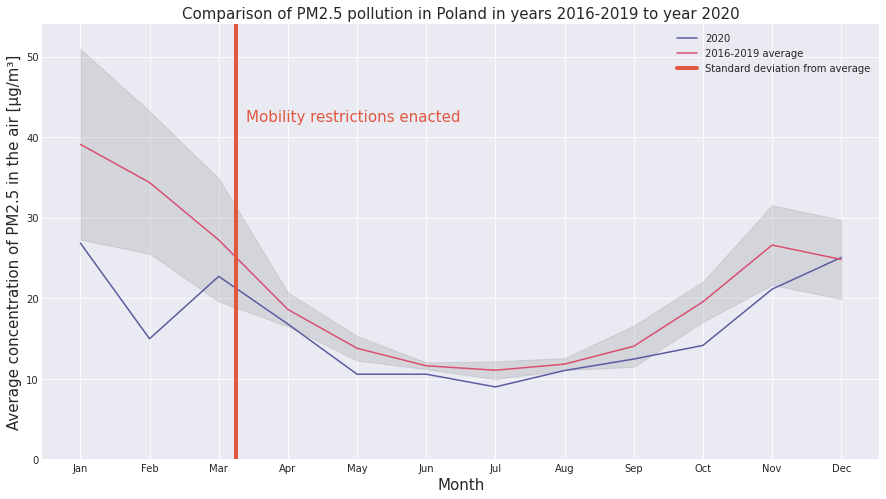

In [36]:
style_url = 'https://raw.githubusercontent.com/dhaitz/matplotlib-stylesheets/master/pacoty.mplstyle'
with plt.style.context(style_url):
    fig, ax = plt.subplots(figsize=(15, 8))
    df = pd.DataFrame(columns = range(1,13))
    years = [2016, 2017, 2018, 2019]
    for i in years:
        df = df.append(pm25[pm25['year'] == i].groupby('month').mean()['data'])
    ax.plot(pm25[pm25['year'] == 2020].groupby('month').mean().index, pm25[pm25['year'] == 2020].groupby('month').mean()['data'])
    ax.plot(df.columns, df.mean())
    ax.fill_between(df.columns, df.mean() - df.std(), df.mean() + df.std(), color='gray', alpha=0.2)
    ax.axvline(x = 3.25,linewidth=4, color='#E2583E')
    ax.text(3.4, 42, 'Mobility restrictions enacted', rotation=0, size=15, color='#E2583E')
    ax.set_xticks(range(1, 13))
    ax.set_yticks(range(1, 55))
    ax.set_yticks([0, 10, 20, 30, 40, 50])
    ax.set_xticklabels(['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
    ax.set_title('Comparison of PM2.5 pollution in Poland in years 2016-2019 to year 2020',size=15)
    ax.set_xlabel('Month',size=15)
    ax.set_ylabel('Average concentration of PM2.5 in the air [μg/m³]',size=15)
    ax.legend(['2020', '2016-2019 average',  'Standard deviation from average'])

Here we are looking at the annual average pollution of PM2.5 for the years 2016-2019 and the pollution in 2020. It can be seen that PM2.5 fluctuates quite a lot in the spring; and is lower than in previous years after the announcement of the lockdown in Poland in 2020.

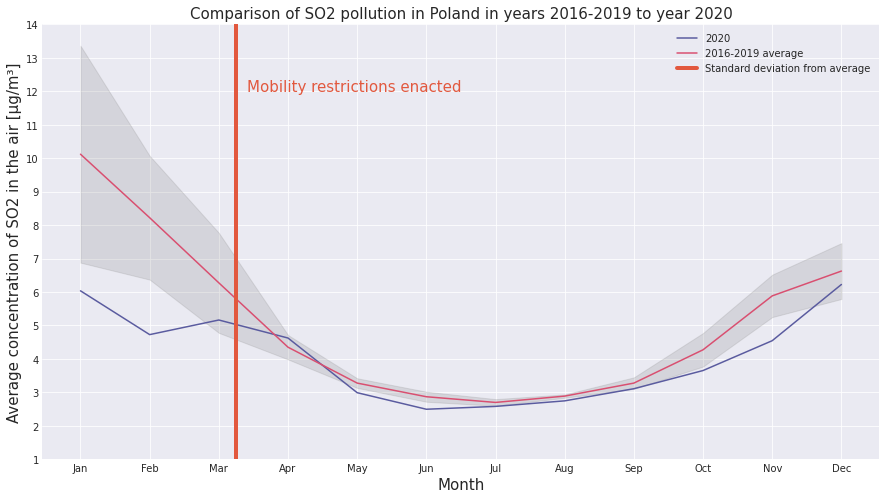

In [37]:
style_url = 'https://raw.githubusercontent.com/dhaitz/matplotlib-stylesheets/master/pacoty.mplstyle'
with plt.style.context(style_url):
    fig, ax = plt.subplots(figsize=(15, 8))
    df = pd.DataFrame(columns = range(1,13))
    years = [2016, 2017, 2018, 2019]
    for i in years:
        df = df.append(So2[So2['year'] == i].groupby('month').mean()['data'])
    ax.plot(So2[So2['year'] == 2020].groupby('month').mean().index, So2[So2['year'] == 2020].groupby('month').mean()['data'])
    ax.plot(df.columns, df.mean())
    ax.fill_between(df.columns, df.mean() - df.std(), df.mean() + df.std(), color='gray', alpha=0.2)
    ax.axvline(x = 3.25,linewidth=4, color='#E2583E')
    ax.text(3.4, 12 ,'Mobility restrictions enacted', rotation=0, size=15, color='#E2583E')
    ax.set_xticks(range(1, 13))
    ax.set_yticks(range(1, 15))
    ax.set_xticklabels(['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
    ax.set_title('Comparison of SO2 pollution in Poland in years 2016-2019 to year 2020',size=15)
    ax.set_xlabel('Month',size=15)
    ax.set_ylabel('Average concentration of SO2 in the air [μg/m³]',size=15)
    ax.legend(['2020', '2016-2019 average',  'Standard deviation from average'])

Here we are looking at annual average pollution in So2 from 2016-2019 and in 2020. so2 also fluctuates more in the spring, but is significantly lower from the spring of 2020; and does not seem to have changed particularly much from previous years after the lockdown was announced.

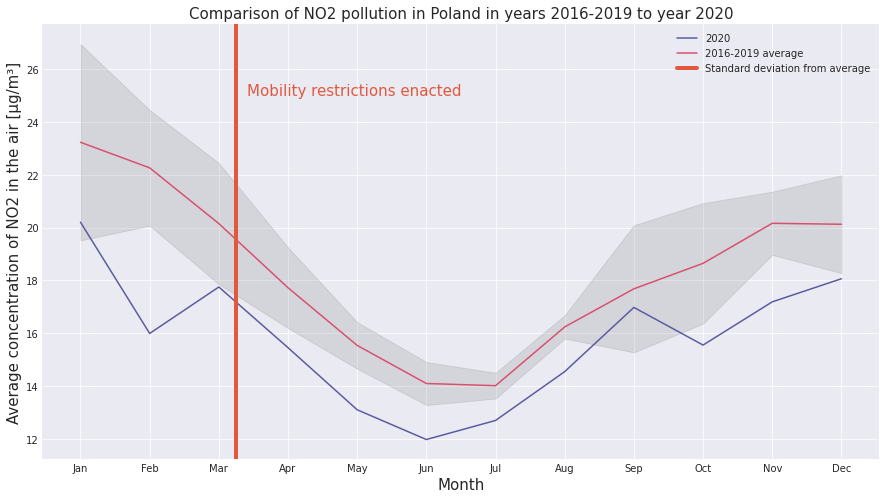

In [38]:
style_url = 'https://raw.githubusercontent.com/dhaitz/matplotlib-stylesheets/master/pacoty.mplstyle'
with plt.style.context(style_url):
    fig, ax = plt.subplots(figsize=(15, 8))
#    ax.set_facecolor('#E6E6E6')
    df = pd.DataFrame(columns = range(1,13))
    years = [2016, 2017, 2018, 2019]
    for i in years:
        df = df.append(No2[No2['year'] == i].groupby('month').mean()['data'])
    ax.plot(No2[No2['year'] == 2020].groupby('month').mean().index, No2[No2['year'] == 2020].groupby('month').mean()['data'])
    ax.plot(df.columns, df.mean())
    ax.fill_between(df.columns, df.mean() - df.std(), df.mean() + df.std(), color='gray', alpha=0.2)
    ax.axvline(x = 3.25,linewidth=4, color='#E2583E')
    ax.text(3.4, 23 ,'Mobility restrictions enacted', rotation=0, size=15, color='#E2583E')
    ax.set_xticks(range(1, 13))
    #ax.set_yticks(range(10, 26))
    ax.set_yticklabels([10, 12, 14, 16, 18, 20, 22, 24, 26])
    ax.set_xticklabels(['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
    ax.set_title('Comparison of NO2 pollution in Poland in years 2016-2019 to year 2020',size=15)
    ax.set_xlabel('Month',size=15)
    ax.set_ylabel('Average concentration of NO2 in the air [μg/m³]',size=15)
    ax.legend(['2020','2016-2019 average', 'Standard deviation from average'])

Here we are looking at the annual average pollution of No2 from 2016-2019 and the pollution in 2020. Then from lockdown onwards; No2 starts to decline and does so more frequently than before.

### 3.1.2 Machine Learing Analysis 

* In our pollution situation, we can see that the data has seasonal variations and fluctuations in the data; so we are not able to conclude from the analysis above whether the pollutants are falling because of lockdown or whether it is just an ordinary phenomenon. 
* So here we are going to use the **ARIMA (Autoregressive Integrated Moving Average model)** in machine learning. We will predict the change in air quality in 2020 based on the data from 2016 to 2019 and compare it with the real data in 2020; thus, we can determine whether the pollutants are changing due to lockdown.

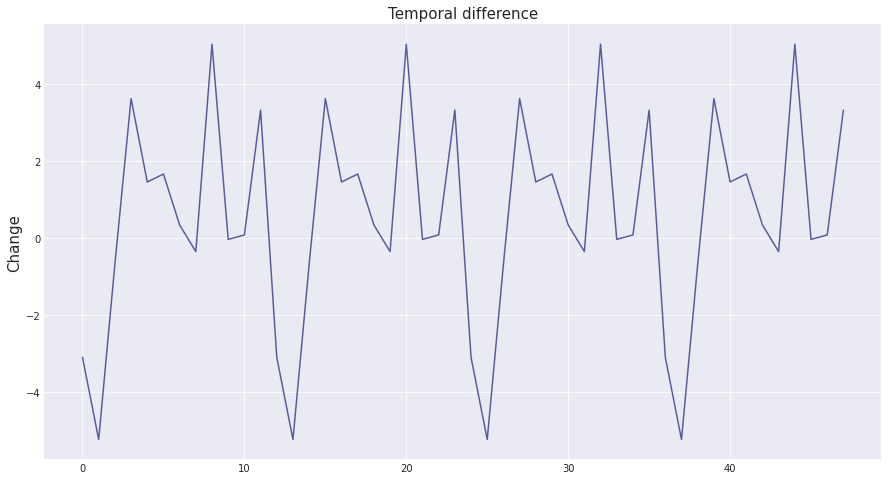

In [39]:
style_url = 'https://raw.githubusercontent.com/dhaitz/matplotlib-stylesheets/master/pacoty.mplstyle'
with plt.style.context(style_url):
    fig, ax = plt.subplots(figsize=(15, 8))
    df = []
    years = [2016, 2017, 2018, 2019]
    for i in years:
        df.append(list((No2[No2['year'] == 2016].groupby('month').mean()['data'] - No2[No2['year'] == 2017].groupby('month').mean()['data'])))
    df = [num for elem in df for num in elem]
    ax.plot(range(48), df)
    ax.set_title('Temporal difference',size=15)
    ax.set_ylabel('Change',size=15)

First we need to differential our data. This is because the data we have now is not smooth (i.e. the data fluctuates according to a certain pattern). And we first need to transform the unsteady data into steady data. This is done by subtracting the data for the same month of the previous year from the data for the same month of the current year. That is, we get the graph above.

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(1,0,1)[4] intercept   : AIC=232.732, Time=0.43 sec
 ARIMA(0,0,0)(0,0,0)[4] intercept   : AIC=255.340, Time=0.01 sec
 ARIMA(1,0,0)(1,0,0)[4] intercept   : AIC=229.657, Time=0.16 sec
 ARIMA(0,0,1)(0,0,1)[4] intercept   : AIC=237.090, Time=0.06 sec
 ARIMA(0,0,0)(0,0,0)[4]             : AIC=408.255, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[4] intercept   : AIC=228.483, Time=0.06 sec
 ARIMA(1,0,0)(0,0,1)[4] intercept   : AIC=229.624, Time=0.08 sec
 ARIMA(1,0,0)(1,0,1)[4] intercept   : AIC=inf, Time=0.31 sec
 ARIMA(2,0,0)(0,0,0)[4] intercept   : AIC=227.777, Time=0.10 sec
 ARIMA(2,0,0)(1,0,0)[4] intercept   : AIC=229.743, Time=0.22 sec
 ARIMA(2,0,0)(0,0,1)[4] intercept   : AIC=229.746, Time=0.15 sec
 ARIMA(2,0,0)(1,0,1)[4] intercept   : AIC=inf, Time=0.27 sec
 ARIMA(3,0,0)(0,0,0)[4] intercept   : AIC=225.185, Time=0.16 sec
 ARIMA(3,0,0)(1,0,0)[4] intercept   : AIC=227.124, Time=0.43 sec
 ARIMA(3,0,0)(0,0,1)[4] intercept   : AIC=227.132, Time

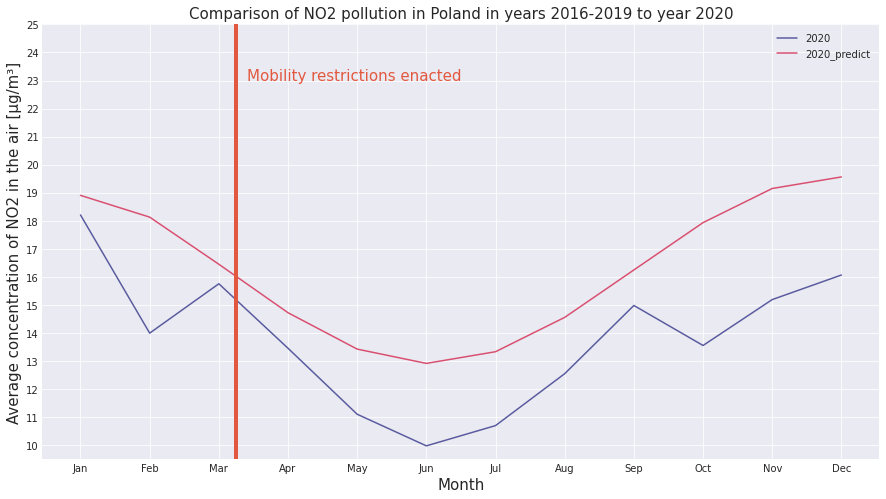

In [40]:
month_range = pd.date_range(start='1/1/16', end='12/1/19', freq='MS')
years = [2016, 2017, 2018, 2019]
df = pd.DataFrame()
temp = []
for i in years:
    df = pd.concat([df, No2[No2['year'] == i].groupby('month').mean()['data']])
df.columns = ['data']
df.set_index(month_range, inplace=True)



model = auto_arima(df['data'],
                   start_p=1, start_q=1,
                   max_p=12, max_q=12,
                   test='kpss',
                   D = None,
                   m=4,
                   seasonal=True,
                   d = None,
                   start_P=1, start_Q=1,
                   max_P=10, max_Q=10,
                   trace=True, error_action='ignore',
                   suppress_warning=True, stepwise=True
                   )

pre = model.predict(n_periods=12, alpha=0.05)
style_url = 'https://raw.githubusercontent.com/dhaitz/matplotlib-stylesheets/master/pacoty.mplstyle'
with plt.style.context(style_url):
    fig, ax = plt.subplots(figsize=(15, 8))
    df = pd.DataFrame(columns = range(1,13))
    years = [2016, 2017, 2018, 2019]
    for i in years:
        df = df.append(No2[No2['year'] == i].groupby('month').mean()['data'])
    ax.plot(No2[No2['year'] == 2020].groupby('month').mean().index, No2[No2['year'] == 2020].groupby('month').mean()['data'])
    ax.plot(range(1,13), pre)
    ax.axvline(x = 3.25,linewidth=4, color='#E2583E')
    ax.text(3.4, 23 ,'Mobility restrictions enacted', rotation=0, size=15, color='#E2583E')
    ax.set_xticks(range(1, 13))
    ax.set_yticks(range(10, 26))
    ax.set_xticklabels(['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
    ax.set_title('Comparison of NO2 pollution in Poland in years 2016-2019 to year 2020',size=15)
    ax.set_xlabel('Month',size=15)
    ax.set_ylabel('Average concentration of NO2 in the air [μg/m³]',size=15)
    ax.legend(['2020','2020_predict' ])

The graph above shows the projected No2 pollution in 2020 and the real pollution in 2020. It can be seen that the pollution of No2 drops significantly after the lockdown. This is the same as our initial hypothesis, which is that the air quality is indeed better due to a reduction in human social activity as a result of the epidemic. The exact reasons for this will be analysed later. Here we have used the auto_arima method to automatically obtain the optimal parameters.

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(1,0,1)[4] intercept   : AIC=336.714, Time=0.33 sec
 ARIMA(0,0,0)(0,0,0)[4] intercept   : AIC=362.501, Time=0.01 sec
 ARIMA(1,0,0)(1,0,0)[4] intercept   : AIC=334.522, Time=0.09 sec
 ARIMA(0,0,1)(0,0,1)[4] intercept   : AIC=341.055, Time=0.09 sec
 ARIMA(0,0,0)(0,0,0)[4]             : AIC=440.724, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[4] intercept   : AIC=333.530, Time=0.07 sec
 ARIMA(1,0,0)(0,0,1)[4] intercept   : AIC=334.345, Time=0.11 sec
 ARIMA(1,0,0)(1,0,1)[4] intercept   : AIC=336.344, Time=0.21 sec
 ARIMA(2,0,0)(0,0,0)[4] intercept   : AIC=331.718, Time=0.12 sec
 ARIMA(2,0,0)(1,0,0)[4] intercept   : AIC=333.583, Time=0.16 sec
 ARIMA(2,0,0)(0,0,1)[4] intercept   : AIC=333.571, Time=0.12 sec
 ARIMA(2,0,0)(1,0,1)[4] intercept   : AIC=335.570, Time=0.34 sec
 ARIMA(3,0,0)(0,0,0)[4] intercept   : AIC=330.654, Time=0.13 sec
 ARIMA(3,0,0)(1,0,0)[4] intercept   : AIC=332.585, Time=0.23 sec
 ARIMA(3,0,0)(0,0,1)[4] intercept   : AIC=332.5

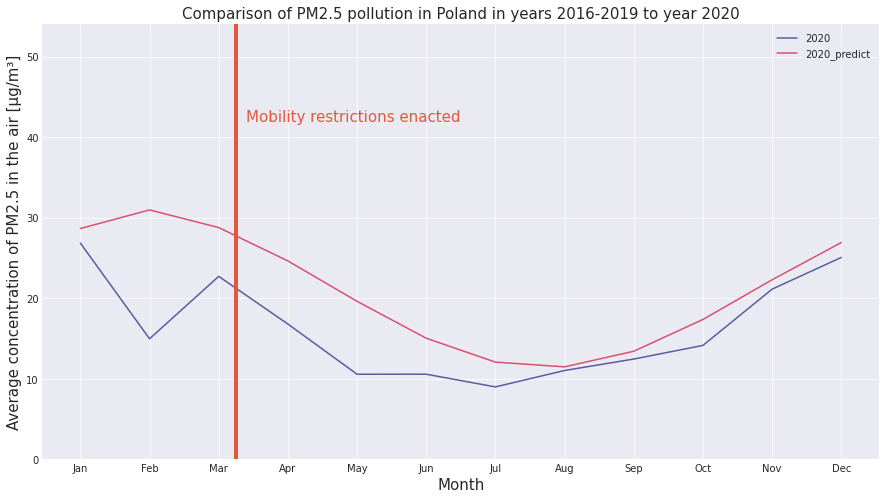

In [41]:
month_range = pd.date_range(start='1/1/16', end='12/1/19', freq='MS')
years = [2016, 2017, 2018, 2019]
df = pd.DataFrame()
temp = []
for i in years:
    df = pd.concat([df, pm25[pm25['year'] == i].groupby('month').mean()['data']])
df.columns = ['data']
df.set_index(month_range, inplace=True)

model = auto_arima(df['data'],
                   start_p=1, start_q=1,
                   max_p=12, max_q=12,
                   test='kpss',
                   D = None,
                   m=4,
                   seasonal=True,
                   d = None,
                   start_P=1, start_Q=1,
                   max_P=10, max_Q=10,
                   trace=True, error_action='ignore',
                   suppress_warning=True, stepwise=True
                   )

pre = model.predict(n_periods=12, alpha=0.05)
style_url = 'https://raw.githubusercontent.com/dhaitz/matplotlib-stylesheets/master/pacoty.mplstyle'
with plt.style.context(style_url):
    fig, ax = plt.subplots(figsize=(15, 8))
    df = pd.DataFrame(columns = range(1,13))
    years = [2016, 2017, 2018, 2019]
    for i in years:
        df = df.append(pm25[pm25['year'] == i].groupby('month').mean()['data'])
    ax.plot(pm25[pm25['year'] == 2020].groupby('month').mean().index, pm25[pm25['year'] == 2020].groupby('month').mean()['data'])
    ax.plot(range(1,13), pre)
    ax.axvline(x = 3.25,linewidth=4, color='#E2583E')
    ax.text(3.4, 42 ,'Mobility restrictions enacted', rotation=0, size=15, color='#E2583E')
    ax.set_xticks(range(1, 13))
    ax.set_xticklabels(['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
    ax.set_yticks(range(1, 55))
    ax.set_yticks([0, 10, 20, 30, 40, 50])
    ax.set_title('Comparison of PM2.5 pollution in Poland in years 2016-2019 to year 2020',size=15)
    ax.set_xlabel('Month',size=15)
    ax.set_ylabel('Average concentration of PM2.5 in the air [μg/m³]',size=15)
    ax.legend(['2020','2020_predict' ])

The previous graph analyses the predicted and actual situation of PM2.5. Here we can clearly see that there seems to be a decrease from 2020 onwards and that the decrease is similar to the predicted one; indicating that PM2.5 may have been influenced by Covid-19 for the better, but not by much.

## 3.2 Energy consumption

And then, let's explore the relationship between changes in air pollutants and energy consumption. Find out why air pollutants are changing.

First of all, according to some articles, we can know:

1.The source of pollutants

* $NO_2$: Emissions mainly from the combustion of fossil fuels and emissions from vehicles such as vehicles<sup>[2,3]</sup>. Additionally, emissions from power plants generate $NO_2$.

* $SO_2$: Emissions mainly from the burning of fossil fuels in power plants and other industrial facilities, especially those burning coal<sup>[4,5]</sup>.

* $PM2.5$: Emissions mainly from gasoline, petroleum, diesel fuel or wood burning<sup>[6,7]</sup>.

2.Pollutants produced by different types of energy after consumption

* Natural gas: Natural gas burns cleaner than coal and oil, producing negligible amounts of sulfur, mercury, and particulate matter. The $NO_x$ produced by burning natural gas is even lower than the amount produced by motor vehicles using gasoline and diesel <sup>[8,9]</sup>.

* Light fuel oil: It has lower sulfur content<sup>[10]</sup>, but also produces $SO_2$, $NO_x$<sup>[11]</sup>.

* Heavy fuel oil: It will generate $SO_2$, $NO_x$<sup>[10]</sup>.

* Liquified petroleum gas (excluding vehicles): It will generate $CO$,$HC$,$NO_x$<sup>[12]</sup>


* Hard coal<sup>[13]</sup>: It will produce $NO_x$,$SO_x$,$PM2.5$<sup>[14]</sup>.

* Heat and electricity: The use of these two energy sources has little impact on the environment, but their production process will have a large impact on the environment. According to the data, electricity and heat production account for about 30% of all CO2 emissions and 26% of all greenhouse gas emissions in the EU-27. The power and heat production processes of thermal power plants (mainly those using coal and natural gas) will generate large amounts of $SO_2$, $NO_x$<sup>[15,16]</sup>.

In general, the use of formally exploited natural gas and the use of heat and electricity have less impact on the environment, so we focus on the remaining consumption of light fuel oil, heavy fuel oil, liquid petroleum gas, and hard coal.

### 3.2.1 Overview

1. Total consumption of every type of energy for total provinces in 2017-2019 and 2020

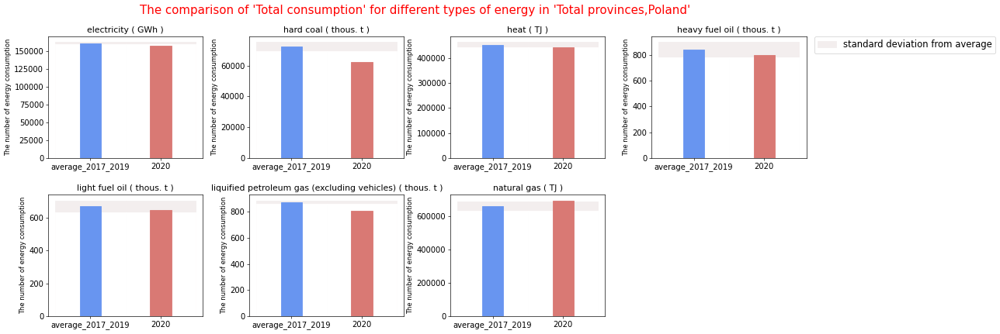

In [ ]:
data3 =pd.read_csv ('/content/gdrive/MyDrive/data_poland_energy_2017-2020_lat.csv')
data_final4=data3.drop(['Unnamed: 0'],axis = 1)
number_original_list2=data_final4['number'].tolist()
number_new_list2=[]

for i in range(len(number_original_list2)):
    if number_original_list2[i]=='–':
        number_new_list2.append(0)
    else:
        number_new_list2.append(int(number_original_list2[i]))
data_final4['trans_number']=pd.DataFrame(np.array(number_new_list2).reshape((len(number_new_list2),1)))
data_final4=data_final4.drop(['number','latitude','longitude'],axis = 1)

type_list=['electricity', 'liquified petroleum gas (excluding vehicles)', 'natural gas', 'heavy fuel oil', 'hard coal', 'light fuel oil', 'heat']
type_unit_list=['GWh','thous. t','TJ','thous. t','thous. t','thous. t','TJ']

def add_unit(x):
    index_=type_list.index(x)
    x=x+' ( '+type_unit_list[index_]+' )'
    return x

def all_province_users(user):
  data_total=data_final4[(data_final4.Province=='Total_all_province,Poland')&(data_final4.SPECIFICATION==user)]
  result_average_total=[]
  result_2020_total=[]
  type_list_total=[]
  up_list_total=[]
  down_list_total=[]
  for group_name,group_data in data_total.groupby(by='Type of energy consumption'):

      df_2017_total=group_data[(group_data.year==2017)]
      df_2018_total=group_data[(group_data.year==2018)]
      df_2019_total=group_data[(group_data.year==2019)]
      df_2020_total=group_data[(group_data.year==2020)]

      y_2017_total=int(df_2017_total['trans_number'].values)    
      y_2018_total=int(df_2018_total['trans_number'].values)
      y_2019_total=int(df_2019_total['trans_number'].values)
      y_2020_total=int(df_2020_total['trans_number'].values)
      y_average_2017_2019_total=(y_2017_total+y_2018_total+y_2019_total)/3
      y_std_total=np.std([y_2017_total,y_2018_total,y_2019_total])
      up_possible_total=y_average_2017_2019_total+y_std_total
      down_possible_total=y_average_2017_2019_total-y_std_total

      result_average_total.append(y_average_2017_2019_total)
      result_2020_total.append(y_2020_total)
      type_list_total.append(group_name)
      up_list_total.append(up_possible_total)
      down_list_total.append(down_possible_total)

  type_list_total=[add_unit(i) for i in type_list_total]
  plt.figure(dpi=60,figsize=(21,17))
  for i in range(len(type_list_total)):
      x=['average_2017_2019','2020']
      y=[result_average_total[i],result_2020_total[i]]
      x_position=list(range(len(y)))
      plt.subplot(4,4,i+1)
      plt.subplots_adjust(hspace=0.3, wspace=0.3)

      bar_up=plt.bar(x,[up_list_total[i],up_list_total[i]],width=1,label='standard deviation from average')
      bar_up[0].set_color('#f3eeee')
      bar_up[1].set_color('#f3eeee')

      bar_down=plt.bar(x,[down_list_total[i],down_list_total[i]],width=1)
      bar_down[0].set_color('white')
      bar_down[1].set_color('white')

      bar=plt.bar(x,y,width=0.3)
      bar[0].set_color('#6895f0')
      bar[1].set_color('#d97974')

      plt.ylabel('The number of energy consumption')
      
      plt.tick_params(labelsize=12)#set the size of the font on the x-axis and y-axis
      plt.title(type_list_total[i],fontsize=13)
      if i== 3:
        plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0,fontsize=14) 
        
        
  plt.suptitle('The comparison of \''+user+'\' for different types of energy in \''+'Total provinces,Poland'+'\'', x=0.5, y=0.92, fontsize=18, color= 'red')

  plt.show()

all_province_users('Total consumption')

The above figure is composed of 7 sub-graphs, which represent the total consumption of all users (the sum of 'transport', 'household', and other users) of different types of energy in 16 Polish provinces in 2017-2019 and 2020 respectively.

The grey area is drawn by taking the average value for 2017-2019 and extending it up and down by a standard deviation for 2017-2019 respectively. We assume that if the value for 2020 is in this range, it is a normal situation, and if it is outside this range, it is an anomaly.

**Phenomenon**:

* The graph shows that in 2020 the consumption of <font color =red>'electricity', 'hard coal', and 'liquefied petroleum gas' </font>in Poland is significantly lower than the average consumption in 2017-2019 and even lower than the average of these three years minus the standard deviation between them.

* For <font color =red>'heat', 'heavy fuel oil', and 'light fuel oil'</font>, their consumption also decreased slightly compared to the average of the previous three years. However, in general, the consumption in 2020 is still greater than or close to the floor of the mean minus the standard deviation of the previous three years, and is still at a normal level compared to 'electricity', 'hard coal', and 'liquefied petroleum gas'.

* In contrast to the other energy sources, for <font color =red>'natural gas'</font>, consumption in 2020 has increased significantly, even exceeding the upper limit representing the mean plus standard deviation of the previous three years.

**Phenomenon analysis**:

We mainly focus on the relationship between <font color =red>air pollution</font> and <font color =red>energy consumption</font>. We focus on the changes of three types of air pollution, <font color =red>$NO_2$, $SO_2$ and $PM2.5$</font> after the lockdown  in 2020.

* It can be obtained from the paper that the reduction of electricity consumption caused by Lockdown restricts human activities will lead to the reduction of $NO_2$ emissions<sup>[17]</sup>. We can see from the graph that <font color =red>'electricity'</font> consumption in 2020 has indeed dropped significantly, so we can infer that the significant reduction in $NO_2$ emissions has a strong relationship with this phenomenon.

* At the same time, the significant reduction in the consumption of <font color =red>'hard coal', 'liquified petroleum gas'</font> and the small reduction in <font color =red>'heavy fuel oil', 'light fuel oil'</font> is an important factor in the reduction of $NO_2$, $SO_2$ and $PM2.5$.

* According to reports, the increase in the use of <font color =red>'natural gas'</font> and the decrease in coal consumption may be due to economic factors within Poland. The increase in the price of coal in 2020 has made coal-based power generation uncompetitive, and the advent of COVID-19 may also have led to a further reduction in coal demand. At the same time, there has been a significant increase in natural gas and renewable energy-based power generation in the country. And Poland's energy mix is also gradually being restructured. 'The Energy Policy until 2040' (PEP2040), adopted in February 2021, reportedly assumes that Poland will gradually reduce the use of coal, on which it relies for 70% of its energy.By 2030, Poland's energy mix will reduce its reliance on coal to at least 56%<sup>[18]</sup>. Therefore, not only due to the lockdown, but also due to its national and economic policies, the increased use of natural gas and clean energy, and the reduction in the use of other fossil fuels such as coal, the amount of domestic pollution will decline. This is also consistent with what we observed from the above graph.

### 3.2.2 Verification of the rationality

1. 'Total consumption' for each province in 2017-2020

And then, we drill down from the overall energy consumption of Poland to the energy consumption of the provinces. Explore whether the changes in energy consumption in each province are consistent with the overall changes, or whether some provinces have a greater impact on the overall energy changes. Then explore whether our overall statistics of energy consumption are consistent with the changes in energy consumption in most provinces.

In [ ]:
data2 =pd.read_csv ('/content/gdrive/MyDrive/data_poland_energy_2017-2020_mod.csv')
data_final3=data2.drop(['Unnamed: 0'],axis = 1)

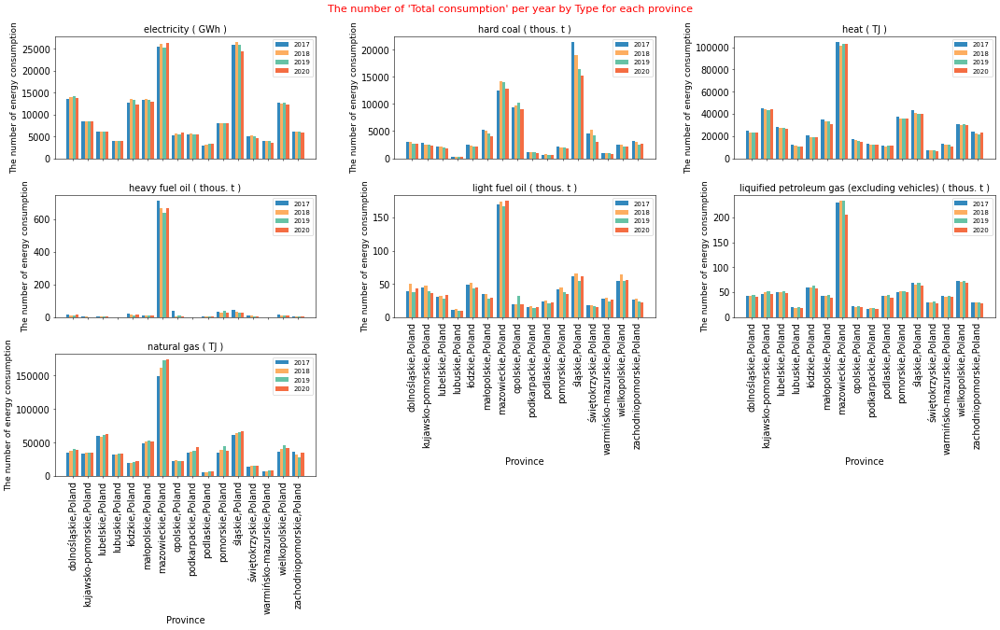

In [ ]:
plt.figure(dpi=50,figsize=(26,17))
i=1

df_draw=data_final3[(data_final3.SPECIFICATION=='Total consumption')]


for group_name,group_data in df_draw.groupby(by='Type of energy consumption'):

    df_2017=group_data[(group_data.year==2017)]
    df_2018=group_data[(group_data.year==2018)]
    df_2019=group_data[(group_data.year==2019)]
    df_2020=group_data[(group_data.year==2020)]
    

    x_2017=list(df_2017['Province'].values)
    y_2017=list(df_2017['trans_number'].values)
    x_2018=list(df_2018['Province'].values)
    y_2018=list(df_2018['trans_number'].values)
    x_2019=list(df_2019['Province'].values)
    y_2019=list(df_2019['trans_number'].values)
    x_2020=list(df_2020['Province'].values)
    y_2020=list(df_2020['trans_number'].values)
    
    width=0.2
    # Adjust the position of different column charts
    x_2017_position = list(range(len(x_2017)))
    x_2018_position = [i+width for i in x_2017_position]
    x_2019_position = [i+2*width for i in x_2017_position]
    x_2020_position = [i+3*width for i in x_2017_position]
    x_label_position= [i+1.5*width for i in x_2017_position]

    plt.subplot(4,3,i)
    plt.subplots_adjust(hspace=0.3, wspace=0.3)
    
    plt.bar(x_2017_position,y_2017,width,color= Spectral10[1],label=2017)
    plt.xticks(x_2017_position,'')#Hide the label of the X axis
    
    plt.bar(x_2018_position,y_2018,width,color= Spectral10[6],label=2018)
    plt.xticks(x_2018_position,'')#Hide the label of the X axis
    
    plt.bar(x_2019_position,y_2019,width,color= Spectral10[2],label=2019)
    plt.xticks(x_2019_position,'')#Hide the label of the X axis
    
    plt.bar(x_2020_position,y_2020,width,color= Spectral10[7],label=2020)
    plt.xticks(x_2020_position,'')#Hide the label of the X axis
    
    plt.xticks(x_label_position,'')#Let the labels of all graphs be displayed in the middle
    if i==5 or i==6 or i==7:       
        plt.xticks(x_label_position,x_2017,rotation='vertical')#Display the labels of the X-axis of the last two graphs
        plt.xlabel('Province',fontsize=14)
    plt.tick_params(labelsize=14)#set the size of the font on the x-axis and y-axis
    plt.ylabel('The number of energy consumption',fontsize=13)
    plt.title(add_unit(group_name),fontsize=14)
    i=i+1
    plt.legend() 
    
    
plt.suptitle('The number of \'Total consumption\' per year by Type for each province', x=0.5, y=0.92, fontsize=16, color= 'red')

plt.show()

The above figure is composed of 7 sub-graphs, showing the total consumption of all users(the sum of 'transport', 'household', and other users) of different types of energy in each province each year.

2. The comparison of 'Total consumption' for each province between the average of 2017-2019 and 2020 

Further, for the convenience of analysis, we averaged the data from 2017 to 2019 and compared it with the data in 2020. If you want to see the full data, please see the previous graphs.

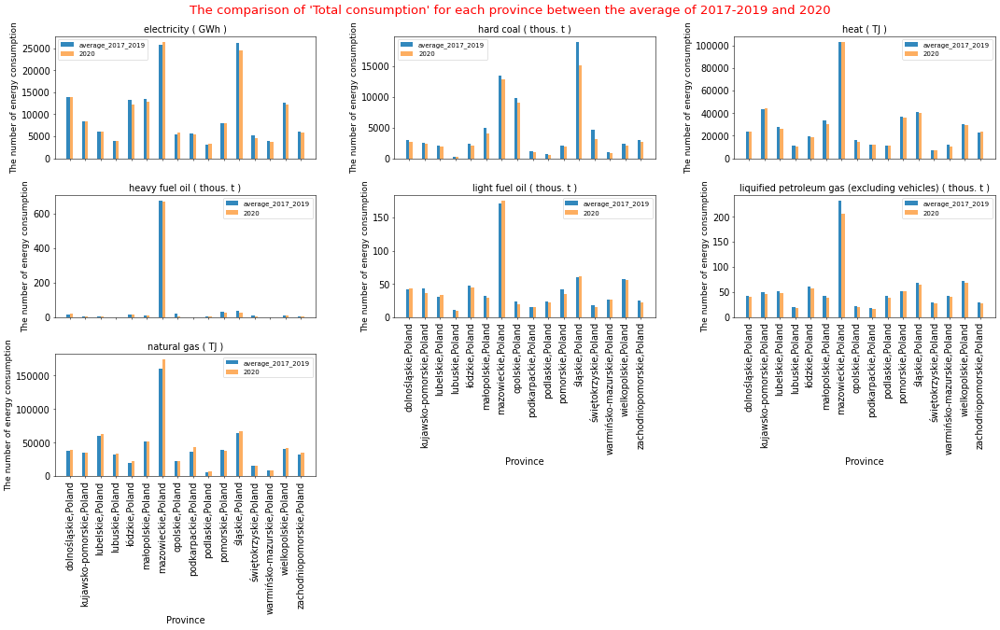

In [ ]:
def average_2017_2019(a,b,c):
  d=[]
  for i in range(len(a)):
    d.append((a[i]+b[i]+c[i])/3)
  return d
  
plt.figure(dpi=50,figsize=(26,17))
i=1

df_draw=data_final3[(data_final3.SPECIFICATION=='Total consumption')]

for group_name,group_data in df_draw.groupby(by='Type of energy consumption'):

    df_2017=group_data[(group_data.year==2017)]
    df_2018=group_data[(group_data.year==2018)]
    df_2019=group_data[(group_data.year==2019)]
    df_2020=group_data[(group_data.year==2020)]
    

    x_2017=list(df_2017['Province'].values)
    y_2017=list(df_2017['trans_number'].values)
    y_2018=list(df_2018['trans_number'].values)
    y_2019=list(df_2019['trans_number'].values)
    y_2020=list(df_2020['trans_number'].values)
    y_average_2017_2019=average_2017_2019(y_2017,y_2018,y_2019)
    
    width=0.2
    # Adjust the position of different column charts
    x_average_2017_2019_position = list(range(len(x_2017)))
    x_2020_position = [i+width for i in x_average_2017_2019_position]
    x_label_position= [i+0.5*width for i in x_average_2017_2019_position]

    plt.subplot(4,3,i)
    
    plt.bar(x_average_2017_2019_position,y_average_2017_2019,width,color= Spectral10[1],label='average_2017_2019')
    plt.xticks(x_average_2017_2019_position,'')#Hide the label of the X axis
    
    plt.bar(x_2020_position,y_2020,width,color= Spectral10[6],label=2020)
    plt.xticks(x_2020_position,'')#Hide the label of the X axis
    
    plt.xticks(x_label_position,'')#Let the labels of all graphs be displayed in the middle
    if i==5 or i==6 or i==7:       
        plt.xticks(x_label_position,x_2017,rotation='vertical')#Display the labels of the X-axis of the last two graphs
        plt.xlabel('Province',fontsize=14)
    
    plt.ylabel('The number of energy consumption',fontsize=13)
    plt.title(add_unit(group_name),fontsize=14)
    plt.subplots_adjust(hspace=0.3, wspace=0.3)
    plt.tick_params(labelsize=14)#set the size of the font on the x-axis and y-axis
    i=i+1
    plt.legend() 
    
    
plt.suptitle('The comparison of \'Total consumption\' for each province between the average of 2017-2019 and 2020', x=0.5, y=0.92, fontsize=19, color= 'red')

plt.show()

The above figure consists of 7 sub-graphs, showing the total consumption of all users (the sum of 'transport', 'household', and other users) of each province for different types of energy in 2017-2019 and 2020.

**Conclusion:**

We can find that the energy consumption of 'mazowieckie, Poland' and 'śląskie, Poland' provinces is significantly higher than that of other provinces, which has a greater impact on the overall energy consumption of Poland. And then, we will use these two provinces as examples to analyze their energy consumption.

3. The comparison of 'Total consumption' for different types of energy between the average of 2017-2019 and 2020 in every province

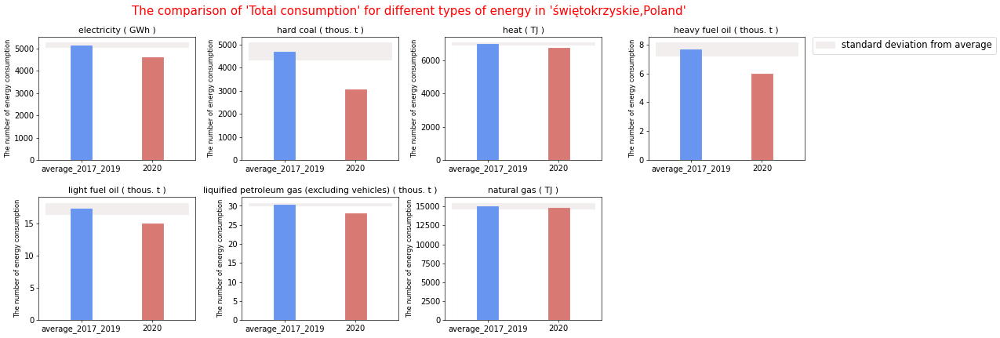

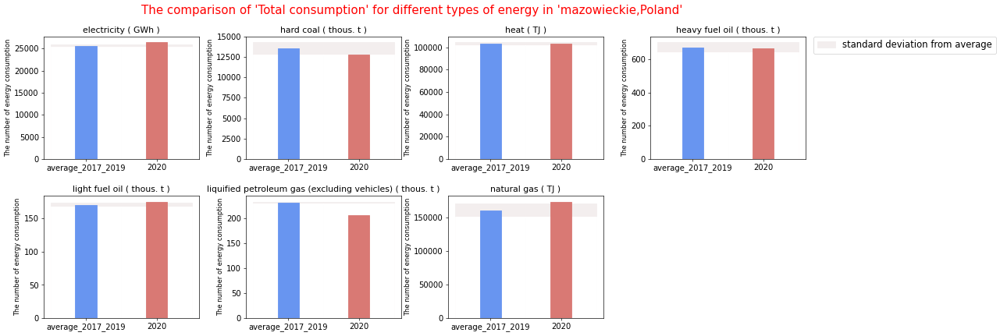

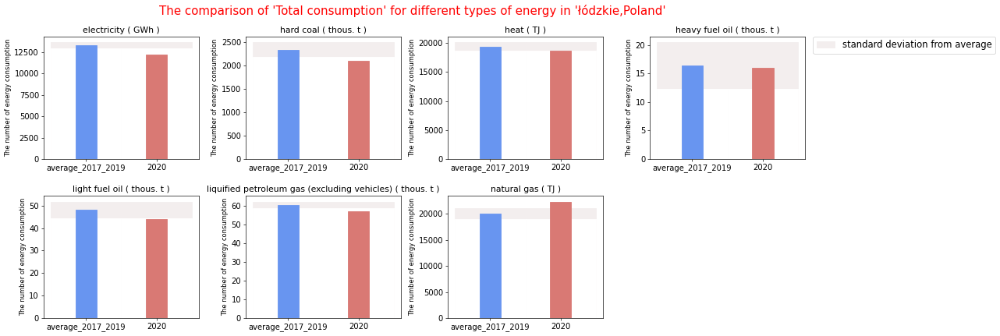

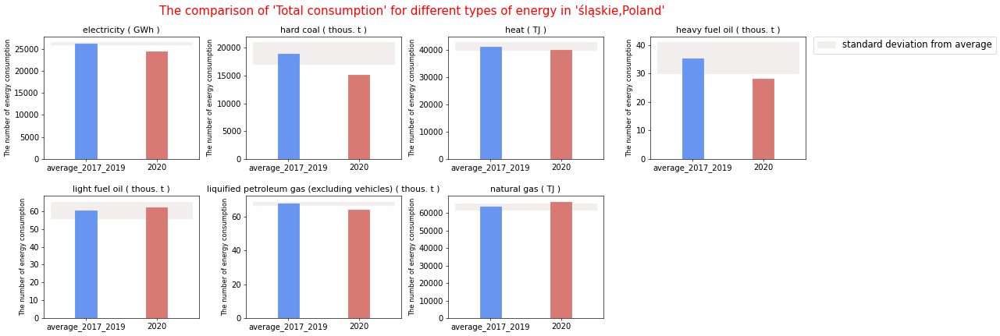

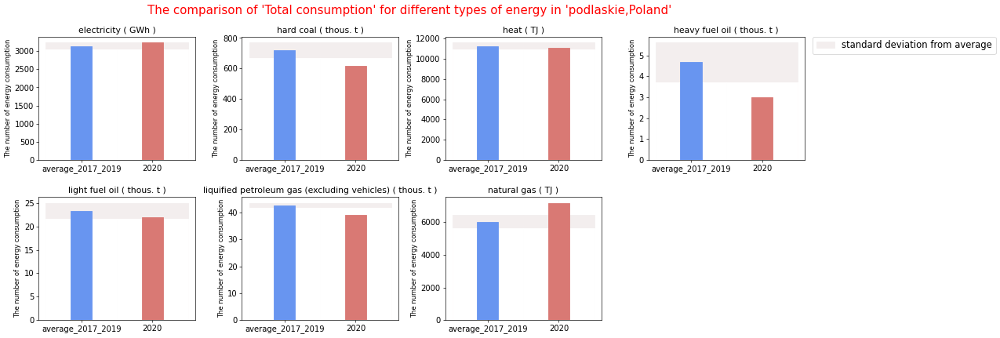

...

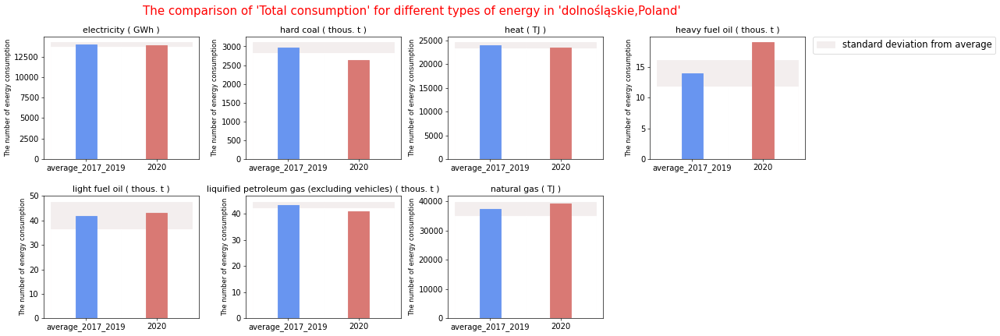

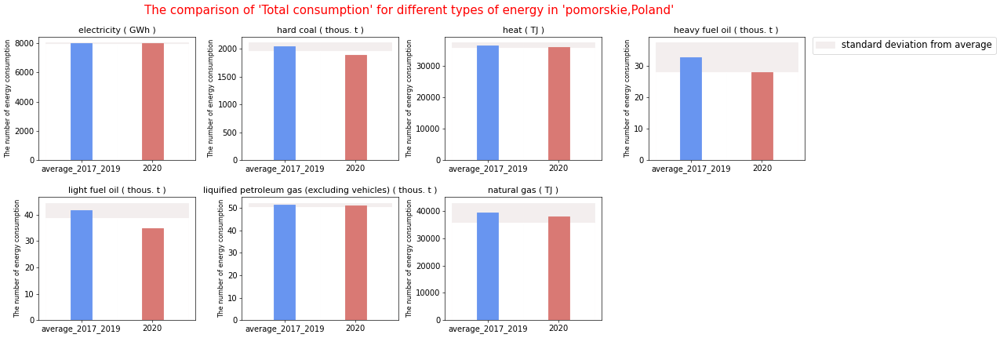

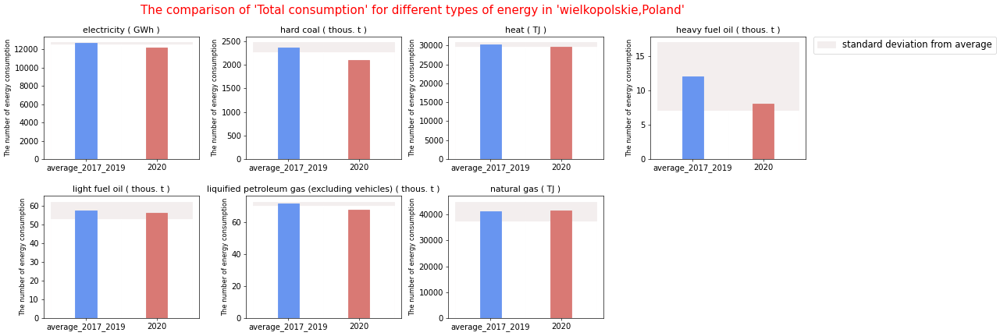

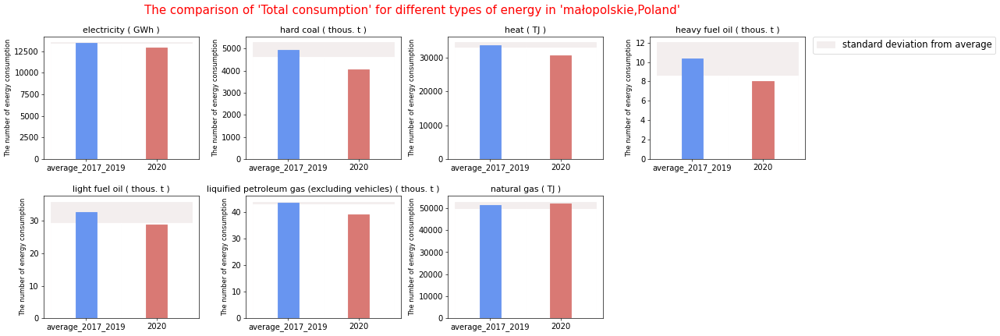

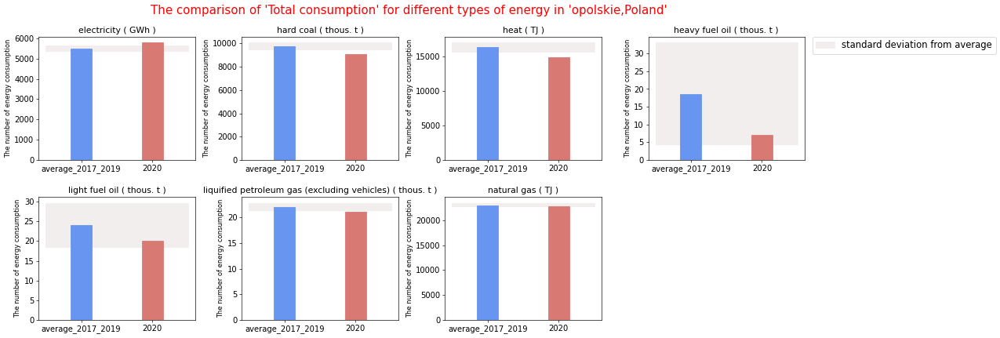

In [ ]:
def show_by_province(a):
  plt.figure(dpi=60,figsize=(21,17))
  df_draw2=data_final3[(data_final3.Province==a)&(data_final3.SPECIFICATION=='Total consumption')]

  result_average=[]
  result_2020=[]
  type_list=[]
  up_list=[]
  down_list=[]
  width=0.3

  for group_name,group_data in df_draw2.groupby(by='Type of energy consumption'):

      df_2017=group_data[(group_data.year==2017)]
      df_2018=group_data[(group_data.year==2018)]
      df_2019=group_data[(group_data.year==2019)]
      df_2020=group_data[(group_data.year==2020)]

      y_2017=int(df_2017['trans_number'].values)    
      y_2018=int(df_2018['trans_number'].values)
      y_2019=int(df_2019['trans_number'].values)
      y_2020=int(df_2020['trans_number'].values)
      y_average_2017_2019=(y_2017+y_2018+y_2019)/3
      y_std=np.std([y_2017,y_2018,y_2019])
      up_possible=y_average_2017_2019+y_std
      down_possible=y_average_2017_2019-y_std

      result_average.append(y_average_2017_2019)
      result_2020.append(y_2020)
      type_list.append(group_name)
      up_list.append(up_possible)
      down_list.append(down_possible)

  type_list=[add_unit(i) for i in type_list]

  # Divided it into 7 graphs, let every type of energy consumption can be shown properly on their own good scale.
  for i in range(len(type_list)):
    x=['average_2017_2019','2020']
    y=[result_average[i],result_2020[i]]
    x_position=list(range(len(y)))
    plt.subplot(4,4,i+1)
    plt.subplots_adjust(hspace=0.3, wspace=0.3)

    bar_up=plt.bar(x,[up_list[i],up_list[i]],width=1,label='standard deviation from average')
    bar_up[0].set_color('#f3eeee')
    bar_up[1].set_color('#f3eeee')

    bar_down=plt.bar(x,[down_list[i],down_list[i]],width=1)
    bar_down[0].set_color('white')
    bar_down[1].set_color('white')

    bar=plt.bar(x,y,width)
    bar[0].set_color('#6895f0')
    bar[1].set_color('#d97974')

    plt.ylabel('The number of energy consumption')
    
    plt.tick_params(labelsize=12)#set the size of the font on the x-axis and y-axis
    plt.title(type_list[i],fontsize=13)
    if i== 3:
      plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0,fontsize=14) 
      
      
  plt.suptitle('The comparison of \'Total consumption\' for different types of energy in \''+a+'\'', x=0.5, y=0.92, fontsize=18, color= 'red')

  plt.show()


select_province=['świętokrzyskie,Poland','mazowieckie,Poland','łódzkie,Poland','śląskie,Poland', 'podlaskie,Poland','lubelskie,Poland', 'kujawsko-pomorskie,Poland', 'zachodniopomorskie,Poland', 'dolnośląskie,Poland', 'pomorskie,Poland', 'wielkopolskie,Poland', 'małopolskie,Poland', 'opolskie,Poland']
for i in select_province:
  show_by_province(i)

The figure above shows the total consumption of all users (the sum of 'transport', 'household', and other users) for different categories of energy in each province in 2017-2019 and 2020.

4. The comparison of 'Total consumption' for different types of energy between the average of 2017-2019 and 2020 in 'mazowieckie,Poland'

Similarly, in order to simplify the analysis, we also select only a few provinces for detailed analysis.

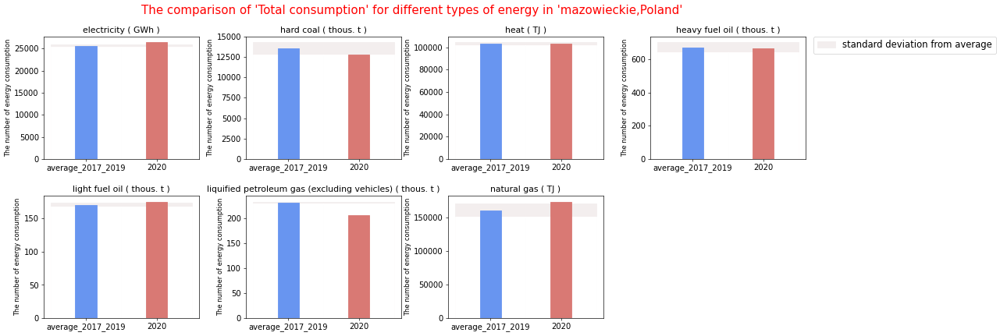

In [ ]:
show_by_province('mazowieckie,Poland')

The graph above shows the energy consumption for all users of various types of energy in the province 'mazowieckie, Poland' in 2017-2019 and 2020. 

**Conclusion:**

From this, we can see some inconsistencies with the overall changes. For this province, the changes in 'electricity' and 'light fuel oil' are contrary to the overall changes, and there has been a significant increase.

As a province with large energy consumption, the province will have a greater impact on the overall change. This also shows that the changes in the provinces themselves do not necessarily match the overall changes.

5. The comparison of 'Total consumption' for different types of energy between the average of 2017-2019 and 2020 in 'śląskie,Poland'

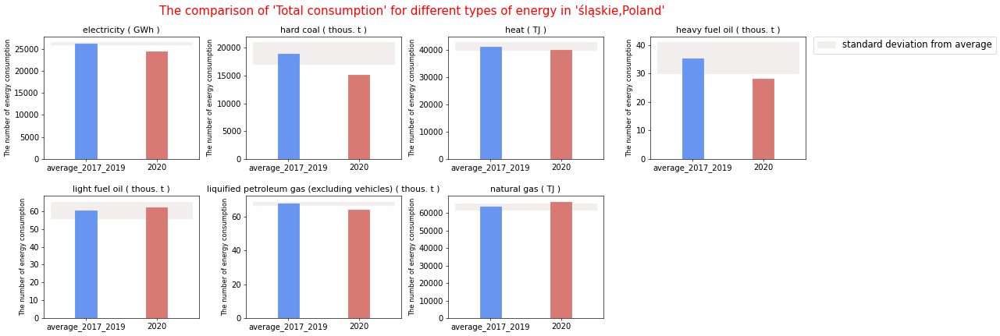

In [ ]:
show_by_province('śląskie,Poland')

The graph above shows the energy consumption for all users of various types of energy in the province ‘śląskie, Poland' in 2017-2019 and 2020.

**Conclusion:**

However, as another province with large energy consumption, it shows a different trend from the province of 'mazowieckie, Poland'. Its energy consumption changes are basically the same as the overall situation, except for 'light fuel oil'. There was a small increase in the consumption of 'light fuel oil'.

6. The comparison of 'Total consumption' for different types of energy between the average of 2017-2019 and 2020 in 'łódzkie,Poland'

Next, in addition to exploring the energy changes in provinces with large energy consumption, let's explore the energy changes in other provinces with small energy consumption as a comparison.

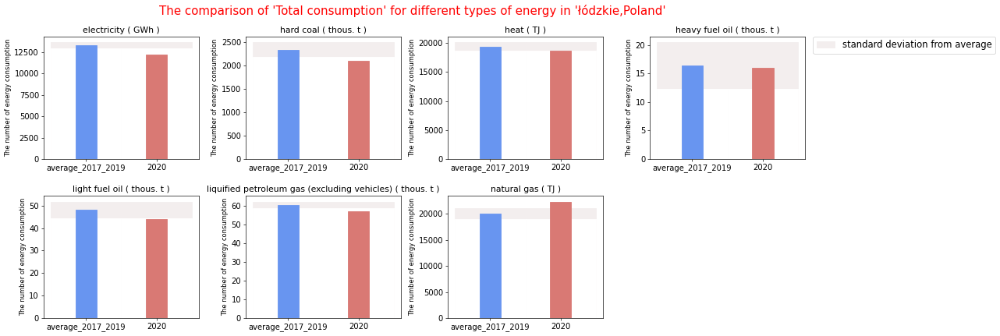

In [ ]:
show_by_province('łódzkie,Poland')

The graph above shows the energy consumption of all users of various types of energy in the province 'łódzkie, Poland' in 2017-2019, and 2020.

**Conclusion:**

We can find that its energy consumption changes are basically consistent with the overall situation.

**Summary:**

To sum up, the change in energy consumption in most provinces is consistent with the overall change, while the change in energy consumption in some of the major energy consuming provinces, although different from the overall, has some impact on the overall statistics. But due to the changes in most of the other provinces being consistent, the other provinces can minimize the impact of the major energy consuming provinces on the overall statistics. Our overall energy consumption statistics still can reflect the energy consumption of most provinces and reduce misleading events such as a province's bias toward the overall statistics.

### 3.2.3 Explore energy consumption from another perspective of different users

Next, we changed from exploring the changes in energy consumption of all users to exploring the changes in energy consumption of different users, so as to explain the reasons for the changes in air pollutants from another perspective.

1. 'Transport' consumption of every type of energy for total provinces in 2017-2019 and 2020

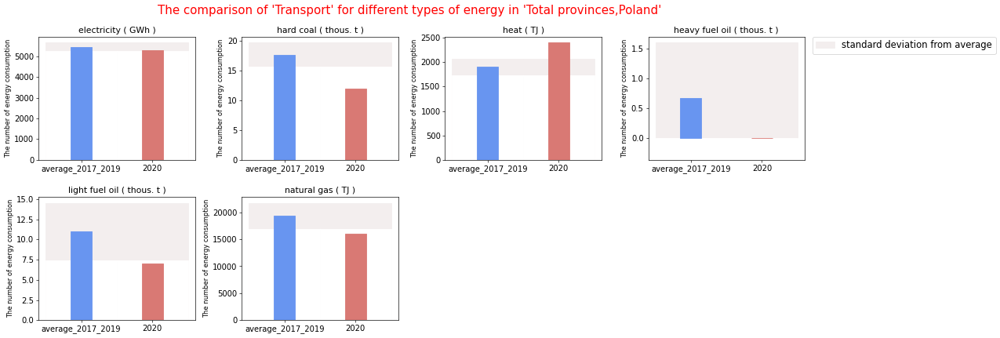

In [ ]:
all_province_users('Transport')

**Conclusion:**

1) Accordind to the article, the main source of $NO_X$ is transportation<sup>[19]</sup>.

We can see from the above figure that in 2020, due to the impact of travel restrictions, the consumption of other energy sources except 'heat' by 'transport' has indeed been significantly reduced compared with the previous three years. It may be a very important reason for the significant decline of $NO_2$ emissions in 2020.

2) At the same time, the sharp decline in the consumption of 'hard coal' is also an important reason for the decline of $SO_2$ and $PM2.5$.

2. 'Households' consumption of every type of energy for total provinces in 2017-2019 and 2020

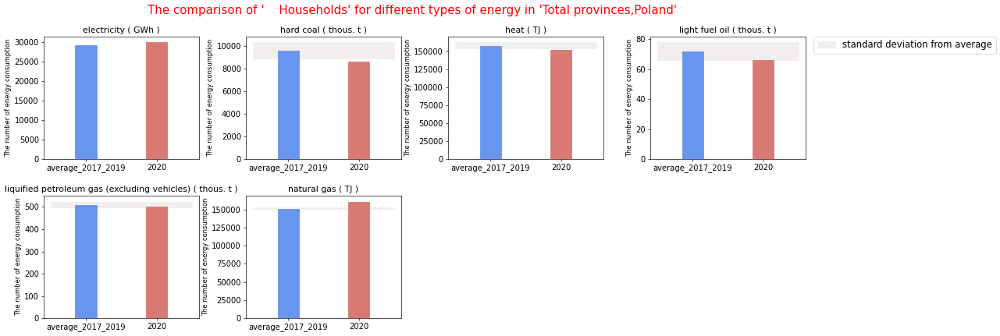

In [ ]:
all_province_users('    Households')

**Conclusion:**

From the above figure, we can see that the electricity consumption of 'households' in 2020 has increased compared with previous years. Due to the impact of the lockdown, people may spend more time at home, resulting in increased consumption of 'electricity'. Similarly, the decline of other energy consumption except 'natural gas' is also an important reason for the decline of $NO_2$, $SO_2$, $PM2.5$.

# Part 4: Genre

## 4.1 Which genre of data story did you use?

**Answers:**  

We chose the interactive slide model from the SLIDE SHOW. Because our data is time-varying, with dynamic changes, and also has static bar charts, this presentation can be very visual and intuitive.



## 4.2 Which tools did you use from each of the 3 categories of Visual Narrative (Figure 7 in Segal and Heer). Why?

**Answers:**

|                     |    Visual Narrative    |
|:-------------------:|:----------------------:|
|  Visual Structuring | Progress Bar / Timebar |
|     Highlighting  | Feature Distinction |                        |
| Transition Guidance |  Continuity Editing                      |

* Since we use time series geographic heatmaps in the visualization of pollutant changes, and use bar charts in energy visualization to count energy consumption in different years, they are all related to time, so the 'Visual Structuring' should be <FONT COLOR=RED>'Progress Bar/Timebar'</FONT>.
* Since in visualization we mainly use color change to distinguish data, 'Highlighting' should be <FONT COLOR=RED>'Feature Distinction'</FONT>.
* We mainly use progressive storytelling to express our themes, so 'Transition Guidance' should be <FONT COLOR=RED>'Continuity Editing'</FONT>.

## 4.3 Which tools did you use from each of the 3 categories of Narrative Structure (Figure 7 in Segal and Heer). Why?

**Answers:**


|               |     Narrative Structure    |
|:-------------:|:--------------------------:|
|    Ordering   |           User Directed Path           |
| Interactivity | Very Limited Interactivity |
|   Messaging   |     Summary / Synthesis    |

* Our entire article goes from exploring the changes in air pollutants before and after COVID-19 to exploring the reasons for this change, to be specific, the relationship between this change and energy consumption. From the shallower to the deeper, gradually guide the reader to generate further thinking. The whole article from 'What', and then to 'Why' gives readers sufficient guidance through comments. So, 'Ordering' should be <FONT COLOR=RED>'User Directed Path'</FONT>.
* Our entire article has little interactivity, so 'Interactivity' should be <FONT COLOR=RED>'Very Limited Interactivity'</FONT>.
* The whole article conveys information to the reader mainly by directly writing the conclusions we observed through the figures, so 'Messaging' should be <FONT COLOR=RED>'Summary/Synthesis'</FONT>.

# Part 5: Visualizations

## 5.1 Explain the visualizations you've chosen.

### 5.1.1 Air quality

**Answers:**
* In part2, according to the monitoring points in each province, we plot the average air pollution in the province. Using choropleth to represent a time-series geographic heat map to show the change in air pollution from 2016 to 2020.
* In part3, a line graph is used to show the change in various pollutants over time.



### 5.1.2 Energy consumption

**Answers:**

* In Part 2, we used the geographic heat map to display the geographic location and data volume of Polish provinces.
*In part3, we used bar graphs for data analysis. We can get the changes in the total energy consumption of 16 provinces across the country, and we also verified that the overall statistical analysis can reflect the changes in most provinces. Also, as a complement, we analyzed the data from another angle - the users.

## 5.2 Why are they right for the story you want to tell?


### 5.2.1 Air quality

**Answers:**
* In part2, because we just collated and cleaned the data and wanted to look at our data as an overview, and as air pollution is also linked to geographical location, we used choropleth to represent this.

* In part3, as we needed to analyse the change in air quality over the last few years, whether it was predicted or real data, we wanted to show the focus on the change. For example, the change in air quality in previous years and the change in air quality now, the change in air quality in 2020 and the predicted change in air quality in 2020. This is why it is clearer to use a line graph representation.

### 5.2.2 Energy consumption

**Answers:**
* In part 2, as a beginning, we want to let the audience more intuitively see where the geographic location of the data we are processing is after cleaning the data so that the audience has a basic understanding to facilitate their thinking and be better able to continue reading down the page. So, we used geographic heatmaps to achieve that. A geographic heat map is a good tool because it can not only clearly show where the area we are analyzing is on the map, but the shade of color on the map reflects that the size of the data volume is largely consistent across provinces, thus giving the audience an idea that the bias caused by the difference in the volume of data is likely to be little in the statistical analysis that follows.

* In part 3, our main goal is to analyze the relationship between air quality changes and energy consumption over the past few years. So similarly, we should still focus on change and explore the relationship between energy consumption in previous years and in 2020. Because the dataset we have from the official website is on a yearly basis and does not have a long time series, we use bar charts to present a clearer picture of how the data deviates in 2020 compared to previous years, allowing the viewer to better grasp the focus for viewing and analysis.

# Part 6: Discussion
**Think critically about your creation.**

## 6.1 What went well?

**Answers:**
* I think our project is environmentally relevant and will give readers an insight into how our human activities have a huge impact on the environment [20]. Especially during covid-19, a large number of human activities were forced to suspend; while many energy-consuming factories also suspended their work. We chose Poland for our study and were surprised that they have comprehensive and rich the air pollution statistics. So it gives us the foundation data to present an interesting story. 
* Next we look at the air quality; comparing the air quality of previous years with the air quality of 2020. It can be concluded that air pollution this year has declined more sharply than in previous years[21]. In order to determine whether is the impact of covid-19. Using machine learning to predict the air quality in 2020, it can be concluded that covid-19 has indeed led to better air quality. 
* Obtaining our conclusion, we started to analyze what the real reasons for this result were. We obtained data on energy consumption in Poland from 2017 to 2020, including coal, electricity, heat, etc. It was found that the consumption of coal is less compared to previous years. The majority of the NO2 and SO2 production comes from the consumption of coal[22], etc. In the end, we conclude that So2, No2, and PM2.5 have all decreased to varying degrees due to the lockdown.

## 6.2 What is still missing? What could be improved? Why?

**Answers:**

Because our analysis of energy consumption is mainly to explain the reasons for changes in pollutants, it is better to obtain a data set of daily statistical energy consumption that is consistent with the way the data sets of pollutant changes are recorded. But it is a pity that there is no data set of energy consumption recorded on a daily basis, not even on a monthly basis, only on a yearly basis. While we have analyzed as many energy consumption trends as possible, we will have more analyses if we could obtain a more precise data set.

# Contributions
- Who did what?

- You should write (just briefly) which group member was the main responsible for which elements of the assignment. (I want you guys to understand every part of the assignment, but usually there is someone who took lead role on certain portions of the work. That's what you should explain).

- It is not OK simply to write "All group members contributed equally".

|              | Energy Consumption Analysis | Air Quality Analysis | Website |
|:------------:|:---------------------------:|:--------------------:|:-------:|
|  Yukang Sun  |                             |         done         |         |
| Yuxuan Zhang |             done            |                      |         |
|     Yu Li    |                             |                      |   done  |

# References

* [1] https://en.wikipedia.org/wiki/Poland
* [2] https://www.airnow.gov/sites/default/files/2018-06/no2.pdf
* [3] https://www.epa.gov/no2-pollution/basic-information-about-no2#What%20is%20NO2
* [4] https://www.epa.gov/so2-pollution/sulfur-dioxide-basics#what%20is%20so2
* [5] https://www.dhs.wisconsin.gov/chemical/sulfurdioxide.htm
* [6] https://ww2.arb.ca.gov/resources/inhalable-particulate-matter-and-health
* [7] https://www.epa.gov/pm-pollution/particulate-matter-pm-basics#PM
* [8] https://www.ucsusa.org/resources/environmental-impacts-natural-gas
* [9] http://naturalgas.org/environment/naturalgas/
* [10] https://www.neste.com/products/all-products/fossil-products/fuel-oils#93eb5bc4
* [11] https://www.samgongustofa.is/media/siglingar/skyrslur/Combustion-of-fossil-fuels-2018-en-1.pdf
* [12] https://www.nettinc.com/information/emissions-faq/what-are-lpg-emissions
* [13] https://www.usgs.gov/faqs/what-are-types-coal
* [14] https://www.sciencedirect.com/science/article/pii/B9780081028865000025
* [15] https://www.eea.europa.eu/data-and-maps/indicators/emissions-co2-so2-nox-from-1
* [16] https://www.epa.gov/ghgemissions/sources-greenhouse-gas-emissions
* [17] https://www.ncbi.nlm.nih.gov/pmc/articles/PMC7604091/
* [18] https://www.trade.gov/country-commercial-guides/poland-energy-sector
* [19] https://www.eea.europa.eu/data-and-maps/indicators/en09-emissions-co2-so2-and/emissions-co2-so2-and-nox
* [20] Nguyen, T. P. M., Bui, T. H., Nguyen, M. K., Nguyen, T. H., Vu, V. T., & Pham, H. L. (2021). Impact of Covid-19 partial lockdown on PM2. 5, SO2, NO2, O3, and trace elements in PM2. 5 in Hanoi, Vietnam. Environmental Science and Pollution Research, 1-11.
* [21] Addas, A., & Maghrabi, A. (2021). The Impact of COVID-19 Lockdowns on Air Quality—A Global Review. Sustainability, 13(18), 10212.
* [22] Benchrif, A., Wheida, A., Tahri, M., Shubbar, R. M., & Biswas, B. (2021). Air quality during three covid-19 lockdown phases: AQI, PM2. 5 and NO2 assessment in cities with more than 1 million inhabitants. Sustainable Cities and Society, 74, 103170.